# Nuclear chromatin phenotypes of PBMCs distinguish control and cancer populations

---
This notebook summarizes the analysis corresponding to the results presented in figure 2 of the paper. It can be used to rerun the analysis and regenerate the corresponding panels.

---

## 0. Environmental setup

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import random
import os
import matplotlib.pyplot as plt
import tifffile
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_validate, StratifiedKFold
from sklearn.metrics import confusion_matrix
from sklearn.metrics import auc
from sklearn.metrics import plot_roc_curve
from sklearn.metrics import roc_curve, roc_auc_score, RocCurveDisplay
from tqdm import tqdm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statannot import add_stat_annotation
from collections import Counter
from imblearn.under_sampling import RandomUnderSampler
from skimage.io import imread
from statsmodels.stats.multitest import fdrcorrection
from scipy.stats import ranksums, ttest_ind
from statannotations.Annotator import Annotator
from collections import Counter
from hdbscan import HDBSCAN

import matplotlib as mpl

mpl.rcParams["figure.dpi"] = 300

import sys
import cv2 as cv

sys.path.append("../..")
from src.utils.notebooks.eda import *

seed = 1234
random.seed(1234)
np.random.seed(1234)

%reload_ext nb_black

<IPython.core.display.Javascript object>

In [2]:
def get_stratified_data(data, id_column="id", cond_column="cancer", seed=1234):
    np.random.seed(seed)
    sampler = RandomUnderSampler(random_state=seed)

    # Subsample such that each patient is represented by the same number of nuclei
    id_labels = np.array(data.loc[:, id_column])
    res_data, res_id_labels = sampler.fit_resample(data, id_labels)

    # Subsample such that we have an equal number of nuclei per condition
    cond_labels = np.array(res_data.loc[:, cond_column])
    res_data, res_cond_labels = sampler.fit_resample(res_data, cond_labels)
    return res_data

<IPython.core.display.Javascript object>

In [3]:
def get_chrometric_data(data, proteins, exclude_dna_int=True):
    data = data._get_numeric_data()
    for protein in proteins:
        data = data[data.columns.drop(list(data.filter(regex=protein)))]
    if exclude_dna_int:
        data = data[data.columns.drop(list(data.filter(regex="dna")))]
        data = data[data.columns.drop(list(data.filter(regex="int")))]
        data = data.drop(columns=["i80_i20"])
    return data

<IPython.core.display.Javascript object>

In [4]:
def get_random_images(
    data,
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
    file_name_col="file_name",
):
    images = []
    np.random.seed(seed)
    sample_idc = np.random.choice(list(range(len(data))), replace=False, size=n_images)
    nuclei_file_names = np.array(data.loc[:, file_name_col])[sample_idc]
    nuclei_dirs = np.array(data.loc[:, data_dir_col])[sample_idc]
    for i in range(len(nuclei_file_names)):
        nuclei_dir = nuclei_dirs[i]
        nuclei_file_name = nuclei_file_names[i]
        image = imread(
            os.path.join(nuclei_dir, image_file_path, nuclei_file_name) + file_ending
        )
        images.append(image)
    return images

<IPython.core.display.Javascript object>

In [5]:
def padding(array, height, width):
    """
    :param array: numpy array
    :param xx: desired height
    :param yy: desirex width
    :return: padded array
    """

    h = array.shape[0]
    w = array.shape[1]

    center_y = (height - h) // 2
    pad_y = height - center_y - h

    center_x = (width - w) // 2
    pad_x = width - center_x - w

    return np.pad(
        array, pad_width=((center_y, pad_y), (center_x, pad_x)), mode="constant"
    )

<IPython.core.display.Javascript object>

In [6]:
def plot_montage(
    images,
    cmap="viridis",
    nrows=6,
    ncols=6,
    figsize=[12, 12],
    pad_size=144,
    mask_nuclei=False,
):
    fig, ax = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols)
    ax = ax.flatten()
    for i in range(len(ax)):
        image = images[i].max(axis=0)[0, :, :]
        mask = images[i].max(axis=0)[-1, :, :]
        if mask_nuclei:
            image = image * mask
        image = padding(image, pad_size, pad_size)
        ax[i].imshow(image, cmap=cmap)
        ax[i].axis("off")
        ax[i].set_aspect("equal")
    plt.subplots_adjust(wspace=0, hspace=0.05)
    return fig, ax

<IPython.core.display.Javascript object>

In [7]:
def get_tsne_embs(data, scale_data=True, seed=1234):
    if scale_data:
        sc = StandardScaler()
        data = pd.DataFrame(
            sc.fit_transform(data), index=data.index, columns=data.columns
        )

    mapper = TSNE(
        random_state=seed,
        n_components=2,
        perplexity=np.ceil(np.sqrt(len(data))),
        init="pca",
        learning_rate="auto",
    )
    embs = pd.DataFrame(
        mapper.fit_transform(data), columns=["tSNE 1", "tSNE 2"], index=data.index
    )
    return embs

<IPython.core.display.Javascript object>

In [8]:
def plot_cv_conf_mtx(
    estimator,
    features,
    labels,
    scale_features=True,
    n_folds=10,
    cmap="viridis",
    figsize=[6, 4],
    seed=1234,
    vmin=0,
    vmax=1,
    fmt=".4f",
    order=None,
):
    if scale_features:
        sc = StandardScaler()
        features = pd.DataFrame(
            sc.fit_transform(features), index=features.index, columns=features.columns
        )

    avg_conf_mtx = compute_avg_conf_mtx(
        model=estimator, n_folds=n_folds, features=features, labels=labels
    )
    if order is not None:
        avg_conf_mtx = avg_conf_mtx.loc[order, order]

    fig, ax = plt.subplots(figsize=figsize)
    ax = sns.heatmap(
        avg_conf_mtx,
        annot=True,
        cmap=cmap,
        ax=ax,
        vmin=vmin,
        vmax=vmax,
        fmt=fmt,
    )
    ax.set_xlabel("Predicted")
    ax.set_ylabel("True")
    return fig, ax

<IPython.core.display.Javascript object>

In [9]:
def plot_feature_importance_for_estimator(
    estimator, features, labels, scale_features=True, cmap="gray", figsize=[6, 4]
):
    if scale_features:
        sc = StandardScaler()
        features = pd.DataFrame(
            sc.fit_transform(features), index=features.index, columns=features.columns
        )
    estimator = estimator.fit(features, labels)
    fig, ax = plot_feature_importance(
        estimator.feature_importances_,
        features.columns,
        "RFC",
        figsize=figsize,
        cmap=cmap,
    )
    ax.set_title("")
    return fig, ax

<IPython.core.display.Javascript object>

In [10]:
def find_markers(data, labels):
    results = []
    i = 0
    for label in tqdm(np.unique(labels), desc="Run marker screen"):
        label_results = {
            "label": [],
            "marker": [],
            "fc": [],
            "abs_delta_fc": [],
            "pval": [],
        }
        for c in data.columns:
            i += 1
            x = np.array(data.loc[labels == label, c])
            y = np.array(data.loc[labels != label, c])
            x = np.array(x[x != np.nan]).astype(float)
            y = np.array(y[y != np.nan]).astype(float)

            pval = ttest_ind(x, y, equal_var=False)[1]
            fc = (np.mean(x) + 1e-15) / (np.mean(y) + 1e-15)
            label_results["label"].append(label)
            label_results["marker"].append(c)
            label_results["fc"].append(fc)
            label_results["abs_delta_fc"].append(abs(fc - 1))
            label_results["pval"].append(pval)
        label_result = pd.DataFrame(label_results)
        label_result.pval = label_result.pval.astype(float)
        label_result = label_result.sort_values("pval")
        results.append(label_result)
    result = pd.concat(results)
    result["pval_adjust"] = fdrcorrection(np.array(result.loc[:, "pval"]))[1]
    return result.sort_values("pval_adjust")

<IPython.core.display.Javascript object>

In [11]:
def plot_marker_distribution(
    data,
    marker,
    label_col,
    box_pairs,
    figsize=[6, 4],
    stat_annot="full",
    hue=None,
    order=None,
    hue_order=None,
    palette=None,
    quantiles=None,
    cut=2,
    plot_type="violin",
):
    fig, ax = plt.subplots(figsize=figsize)
    if quantiles is not None:
        data = data.loc[
            (data.loc[:, marker] < np.quantile(data.loc[:, marker], q=quantiles[1]))
            & (data.loc[:, marker] > np.quantile(data.loc[:, marker], q=quantiles[0]))
        ]
    if plot_type == "violin":
        ax = sns.violinplot(
            data=data,
            x=label_col,
            y=marker,
            hue=hue,
            ax=ax,
            order=order,
            hue_order=hue_order,
            palette=palette,
            width=0.8,
            cut=cut,
        )
    elif plot_type == "bar":
        ax = sns.barplot(
            data=data,
            x=label_col,
            y=marker,
            ax=ax,
            hue=hue,
            hue_order=hue_order,
            order=order,
        )
    else:
        raise NotImplementedError

    annotator = Annotator(
        ax,
        box_pairs,
        data=data,
        x=label_col,
        y=marker,
        hue=hue,
        order=order,
        hue_order=hue_order,
        plot=plot_type + "plot",
    )
    annotator.configure(test="t-test_ind", text_format="star", loc="inside")
    annotator.apply_test()
    annotator.annotate()

    return fig, ax

<IPython.core.display.Javascript object>

In [12]:
def plot_cancer_type_markers_dist(
    data, markers, marker_labels, quantiles=None, cut=2, plot_type="violin"
):
    for i in range(len(markers)):
        fig, ax = plot_marker_distribution(
            data,
            figsize=[6, 4],
            marker=markers[i],
            label_col="cancer",
            order=["glioma", "head&neck", "meningioma"],
            box_pairs=[
                ("glioma", "head&neck"),
                ("glioma", "meningioma"),
                ("head&neck", "meningioma"),
            ],
            stat_annot="star",
            quantiles=quantiles,
            cut=cut,
            plot_type=plot_type,
        )
        ax.set_xlabel("condition")
        ax.set_ylabel(marker_labels[i])
        plt.show()
        plt.close()

<IPython.core.display.Javascript object>

---

## 1. Read in data

To assess the differences in the cancer populations compared to the control population, we obtained PBMCs of 10 healthy control samples and 10 cancer patients of various cancer types. For each patient two sets of experiments were conducted with varying stains: gH2AX together with Lamin A/C and CD4 with CD8. Additionally, all PBMCs were stained for the DNA using DAPI. Thus, for our analysis of the chrometric changes in cancer two replicates are available for each biological sample. We will thus present the analysis for each replicate to show the robustness of our results.

First, we read in the required data sets that describe each PBMCs by a number of hand-crafted features extracted from the fluorescent images of the cells.

#### Data set 1: DNA, gH2AX, Lamin A/C and CD3

In [13]:
mg_rep1_root_data_dir = "../../data/meningioma/proteins/timepoint_1"
feature_file_path = "/preprocessed/full_pipeline/nuclear_features.csv"
qc_result_file_path = "/preprocessed/full_pipeline/segmentation/qc_results.csv"

<IPython.core.display.Javascript object>

In [14]:
mg_rep1_data = read_in_protein_dataset(
    data_dir=mg_rep1_root_data_dir,
    feature_file_path=feature_file_path,
    qc_result_file_path=qc_result_file_path,
)
mg_rep1_data["id"] = mg_rep1_data["sample"] + mg_rep1_data["timepoint"]
mg_rep1_data["cancer"] = "meningioma"
mg_rep1_data["file_name"] = np.array(list(mg_rep1_data.index))

Load data: 100%|██████████| 6/6 [00:00<00:00, 35.36it/s]


<IPython.core.display.Javascript object>

In [15]:
gl_rep1_root_data_dir = "../../data/glioma/proteins/timepoint_1_2"

gl_rep1_data = read_in_protein_dataset(
    data_dir=gl_rep1_root_data_dir,
    feature_file_path=feature_file_path,
    qc_result_file_path=qc_result_file_path,
)
gl_rep1_data["id"] = gl_rep1_data["sample"] + gl_rep1_data["timepoint"]
gl_rep1_data["cancer"] = "glioma"
gl_rep1_data["file_name"] = np.array(list(gl_rep1_data.index))

Load data: 100%|██████████| 8/8 [00:00<00:00, 26.88it/s]


<IPython.core.display.Javascript object>

In [16]:
hn_rep1_root_data_dir = "../../data/headneck/proteins/timepoint_1"

hn_rep1_data = read_in_protein_dataset(
    data_dir=hn_rep1_root_data_dir,
    feature_file_path=feature_file_path,
    qc_result_file_path=qc_result_file_path,
)
hn_rep1_data["id"] = hn_rep1_data["sample"] + hn_rep1_data["timepoint"]
hn_rep1_data["cancer"] = "head&neck"
hn_rep1_data["file_name"] = np.array(list(hn_rep1_data.index))

Load data: 100%|██████████| 8/8 [00:00<00:00, 26.47it/s]


<IPython.core.display.Javascript object>

#### Data set 2: DNA, CD16, CD4 and CD8

In [17]:
mg_rep2_root_data_dir = "../../data/meningioma/marker/timepoint_1"

mg_rep2_data = read_in_protein_dataset(
    data_dir=mg_rep2_root_data_dir,
    feature_file_path=feature_file_path,
    qc_result_file_path=qc_result_file_path,
)
mg_rep2_data["id"] = mg_rep2_data["sample"] + mg_rep2_data["timepoint"]
mg_rep2_data["cancer"] = "meningioma"
mg_rep2_data["file_name"] = np.array(list(mg_rep2_data.index))

Load data: 100%|██████████| 6/6 [00:00<00:00, 33.42it/s]


<IPython.core.display.Javascript object>

In [18]:
gl_rep2_root_data_dir = "../../data/glioma/marker/timepoint_1"

gl_rep2_data = read_in_protein_dataset(
    data_dir=gl_rep2_root_data_dir,
    feature_file_path=feature_file_path,
    qc_result_file_path=qc_result_file_path,
)
gl_rep2_data["id"] = gl_rep2_data["sample"] + gl_rep2_data["timepoint"]
gl_rep2_data["cancer"] = "glioma"
gl_rep2_data["file_name"] = np.array(list(gl_rep2_data.index))

Load data: 100%|██████████| 8/8 [00:00<00:00, 27.25it/s]


<IPython.core.display.Javascript object>

In [19]:
hn_rep2_root_data_dir = "../../data/headneck/marker/timepoint_1"

hn_rep2_data = read_in_protein_dataset(
    data_dir=hn_rep2_root_data_dir,
    feature_file_path=feature_file_path,
    qc_result_file_path=qc_result_file_path,
)
hn_rep2_data["id"] = hn_rep2_data["sample"] + hn_rep2_data["timepoint"]
hn_rep2_data["cancer"] = "head&neck"
hn_rep2_data["file_name"] = np.array(list(hn_rep2_data.index))

Load data: 100%|██████████| 8/8 [00:00<00:00, 30.86it/s]


<IPython.core.display.Javascript object>

---

## 2. Data preprocessing

Before we analyze the data, we will first preprocess it.

To this end, we first remove features with missing values and samples with missing features.

In [20]:
mg_rep1_data = preprocess_data(mg_rep1_data, remove_constant_features=False)
mg_rep2_data = preprocess_data(mg_rep2_data, remove_constant_features=False)

gl_rep1_data = preprocess_data(gl_rep1_data, remove_constant_features=False)
gl_rep2_data = preprocess_data(gl_rep2_data, remove_constant_features=False)

hn_rep1_data = preprocess_data(hn_rep1_data, remove_constant_features=False)
hn_rep2_data = preprocess_data(hn_rep2_data, remove_constant_features=False)

Nuclei that did not pass the quality check: 179/2650. Remaining: 2471.
Removed 32 constant or features with missing values. Remaining: 271.
Removed additional 6 features. Remaining: 265.
Nuclei that did not pass the quality check: 221/2950. Remaining: 2729.
Removed 12 constant or features with missing values. Remaining: 290.
Removed additional 6 features. Remaining: 284.
Nuclei that did not pass the quality check: 183/3566. Remaining: 3383.
Removed 12 constant or features with missing values. Remaining: 291.
Removed additional 6 features. Remaining: 285.
Nuclei that did not pass the quality check: 283/4363. Remaining: 4080.
Removed 12 constant or features with missing values. Remaining: 290.
Removed additional 6 features. Remaining: 284.
Nuclei that did not pass the quality check: 329/4406. Remaining: 4077.
Removed 9 constant or features with missing values. Remaining: 294.
Removed additional 6 features. Remaining: 288.
Nuclei that did not pass the quality check: 180/4235. Remaining: 4

<IPython.core.display.Javascript object>

___

#### Subsampling

We first subsample the data set such that for each condition (control vs. cancer) we have the same number of nuclei in the data set. Additionally, we ensure that for the cancer population we have approximately equal number of nuclei from each biological sample.

In [21]:
rep1_data = mg_rep1_data.append(gl_rep1_data).append(hn_rep1_data)
rep1_data.index = list(range(len(rep1_data)))
rep2_data = mg_rep2_data.append(gl_rep2_data).append(hn_rep2_data)
rep2_data.index = list(range(len(rep2_data)))

sampled_rep1_data = get_stratified_data(
    rep1_data, id_column="id", cond_column="cancer", seed=1234
)
sampled_rep2_data = get_stratified_data(
    rep2_data, id_column="id", cond_column="cancer", seed=1234
)

<IPython.core.display.Javascript object>

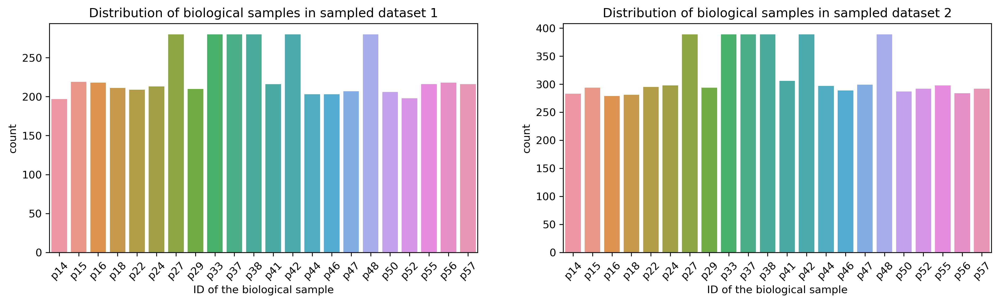

<IPython.core.display.Javascript object>

In [22]:
fig, ax = plt.subplots(figsize=[16, 4], ncols=2)
ax = ax.flatten()
ax[0] = sns.countplot(
    x="sample",
    data=sampled_rep1_data,
    ax=ax[0],
    order=np.unique(sampled_rep1_data.loc[:, "sample"]),
)
ax[1] = sns.countplot(
    x="sample",
    data=sampled_rep2_data,
    ax=ax[1],
    order=np.unique(sampled_rep2_data.loc[:, "sample"]),
)
for i in range(2):
    ax[i].set_xlabel("ID of the biological sample")
    ax[i].set_title(
        "Distribution of biological samples in sampled dataset {}".format(i + 1)
    )
    for tick in ax[i].get_xticklabels():
        tick.set_rotation(45)
plt.show()
plt.close()

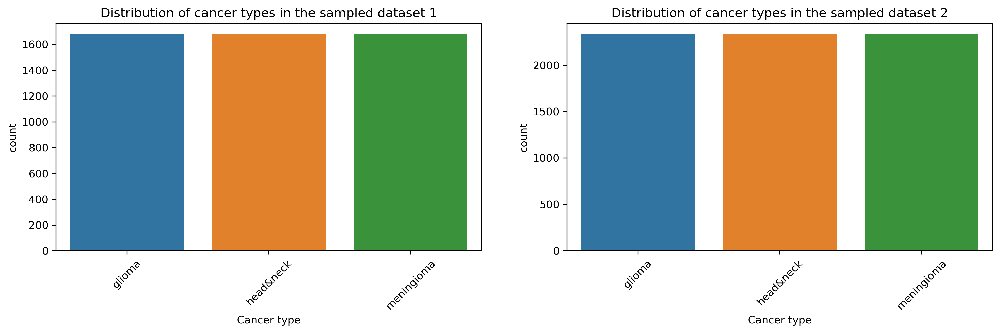

<IPython.core.display.Javascript object>

In [23]:
fig, ax = plt.subplots(figsize=[16, 4], ncols=2)
ax = ax.flatten()
ax[0] = sns.countplot(
    x="cancer",
    data=sampled_rep1_data,
    ax=ax[0],
    order=np.unique(sampled_rep1_data.loc[:, "cancer"]),
)
ax[1] = sns.countplot(
    x="cancer",
    data=sampled_rep2_data,
    ax=ax[1],
    order=np.unique(sampled_rep2_data.loc[:, "cancer"]),
)
for i in range(2):
    ax[i].set_xlabel("Cancer type")
    ax[i].set_title(
        "Distribution of cancer types in the sampled dataset {}".format(i + 1)
    )
    for tick in ax[i].get_xticklabels():
        tick.set_rotation(45)
plt.show()
plt.close()

----

#### Sample and feature selection

We now filter out constant features and nuclei with missing features. We will do that for both replicates individually. However, we will also combine the two replicates to provide a joint analysis.

In [24]:
rep1_data = preprocess_data(sampled_rep1_data, remove_constant_features=True)
rep2_data = preprocess_data(sampled_rep2_data, remove_constant_features=True)

Nuclei that did not pass the quality check: 0/5040. Remaining: 5040.
Removed 28 constant or features with missing values. Remaining: 260.
Removed additional 0 features. Remaining: 260.
Nuclei that did not pass the quality check: 0/7002. Remaining: 7002.
Removed 6 constant or features with missing values. Remaining: 278.
Removed additional 0 features. Remaining: 278.


<IPython.core.display.Javascript object>

In [25]:
sampled_rep1_data["rep"] = "1"
sampled_rep2_data["rep"] = "2"

data = preprocess_data(
    sampled_rep1_data.append(sampled_rep2_data), remove_constant_features=True
)
data.index = list(range(len(data)))

Nuclei that did not pass the quality check: 0/12042. Remaining: 12042.
Removed 128 constant or features with missing values. Remaining: 221.
Removed additional 0 features. Remaining: 221.


<IPython.core.display.Javascript object>

---

#### Data preparation

After sampling the data, we will now prepare the data for the consecutive analysis, i.e. extracting only chrometric features and corresponding metadata information.

In [26]:
chrometric_rep1_data = get_chrometric_data(
    rep1_data,
    proteins=["gh2ax", "lamin", "cd3"],
    exclude_dna_int=True,
)
chrometric_rep2_data = get_chrometric_data(
    rep2_data, proteins=["cd4", "cd8", "c16"], exclude_dna_int=True
)

rep1_sample_labels = rep1_data.loc[:, "sample"]
rep2_sample_labels = rep2_data.loc[:, "sample"]

rep1_cancer_labels = rep1_data.cancer
rep2_cancer_labels = rep2_data.cancer

<IPython.core.display.Javascript object>

In [27]:
chrometric_data = get_chrometric_data(data, proteins=[], exclude_dna_int=True)
sample_labels = data.loc[:, "sample"]
cancer_labels = data.cancer
rep_labels = data.rep

<IPython.core.display.Javascript object>

Finally, we remove highly correlated features (Pearson $\rho > 0.8$) from the chrometric features.

In [28]:
chrometric_rep1_data = remove_correlated_features(chrometric_rep1_data, threshold=0.8)
chrometric_rep2_data = remove_correlated_features(chrometric_rep2_data, threshold=0.8)

Removed 139/193 features with a Pearson correlation above 0.8. Remaining: 54
Removed 139/193 features with a Pearson correlation above 0.8. Remaining: 54


<IPython.core.display.Javascript object>

In [29]:
chrometric_data = remove_correlated_features(chrometric_data, threshold=0.8)

Removed 133/193 features with a Pearson correlation above 0.8. Remaining: 60


<IPython.core.display.Javascript object>

---

## 3. Panels

Now we generate the individual panels for figure 2 of the paper.


### 3a. Visualization of the global nuclear phenotypes of control vs cancer population

First, we provide a visual representation of the different nuclear phenotypes in health and cancer. To this end, we will randomly sample 36 nuclei from each condition and plot a corresponding montage of the max-z projected DNA images. To visualize size differences each nuclei is padded to a size of 96x96 pixels.

In [30]:
image_file_path = "preprocessed/full_pipeline/segmentation/nuclei_images"
sampled_mg_rep1_images = get_random_images(
    rep1_data.loc[rep1_data.cancer == "meningioma"],
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
    file_name_col="file_name",
)
sampled_mg_rep2_images = get_random_images(
    rep2_data.loc[rep2_data.cancer == "meningioma"],
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
    file_name_col="file_name",
)

sampled_gl_rep1_images = get_random_images(
    rep1_data.loc[rep1_data.cancer == "glioma"],
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
    file_name_col="file_name",
)
sampled_gl_rep2_images = get_random_images(
    rep2_data.loc[rep2_data.cancer == "glioma"],
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
    file_name_col="file_name",
)

sampled_hn_rep1_images = get_random_images(
    rep1_data.loc[rep1_data.cancer == "head&neck"],
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
    file_name_col="file_name",
)
sampled_hn_rep2_images = get_random_images(
    rep2_data.loc[rep2_data.cancer == "head&neck"],
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
    file_name_col="file_name",
)

<IPython.core.display.Javascript object>

### Dataset 1

#### Meningioma population

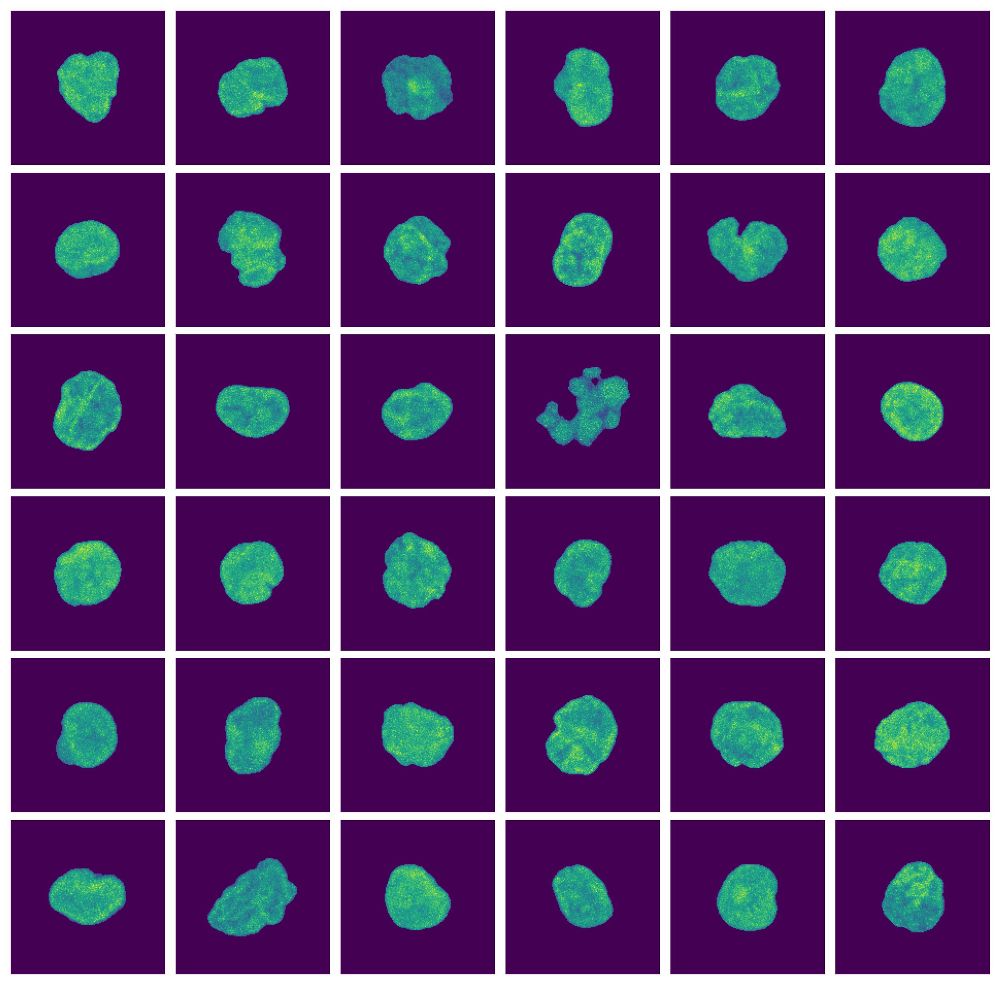

<IPython.core.display.Javascript object>

In [31]:
fig_rep1_mg, ax_rep1_mg = plot_montage(
    sampled_mg_rep1_images, pad_size=150, mask_nuclei=True
)

#### Glioma population

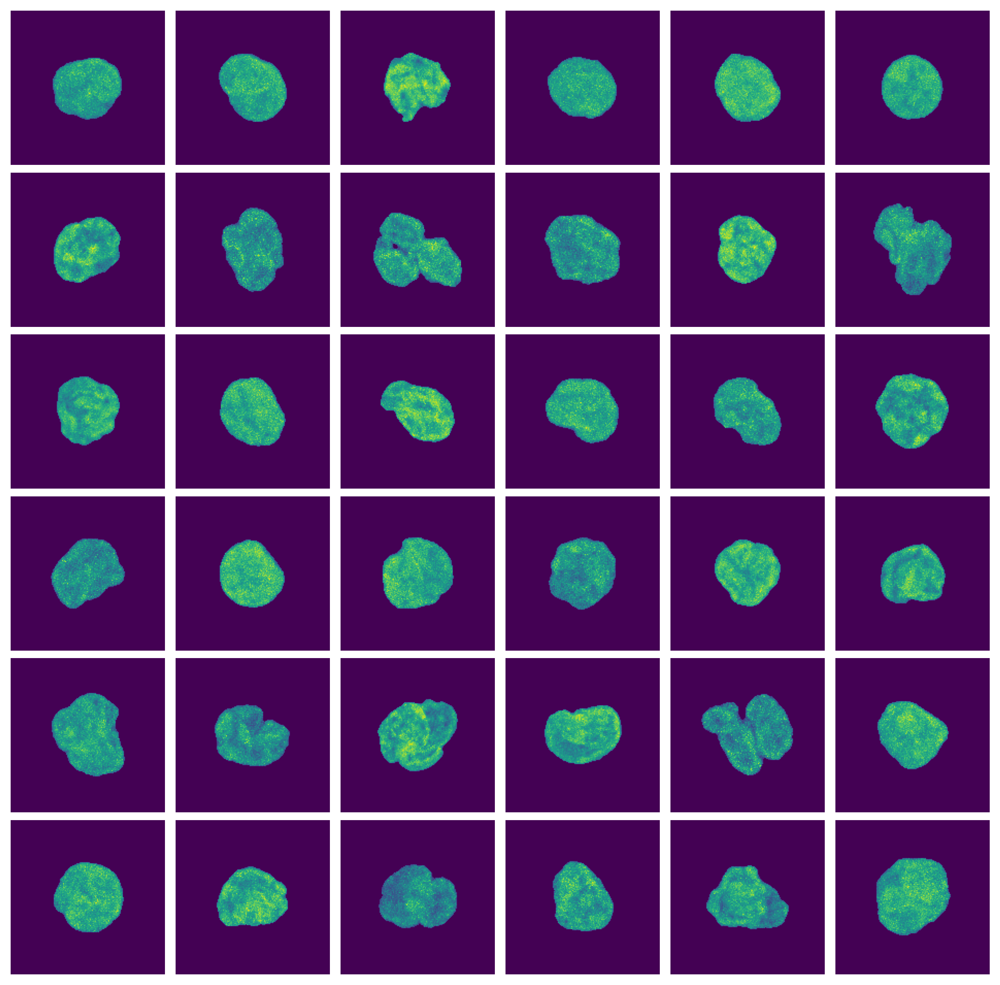

<IPython.core.display.Javascript object>

In [32]:
fig_rep1_gl, ax_rep1_gl = plot_montage(
    sampled_gl_rep1_images, pad_size=150, mask_nuclei=True
)

#### Head & Neck population

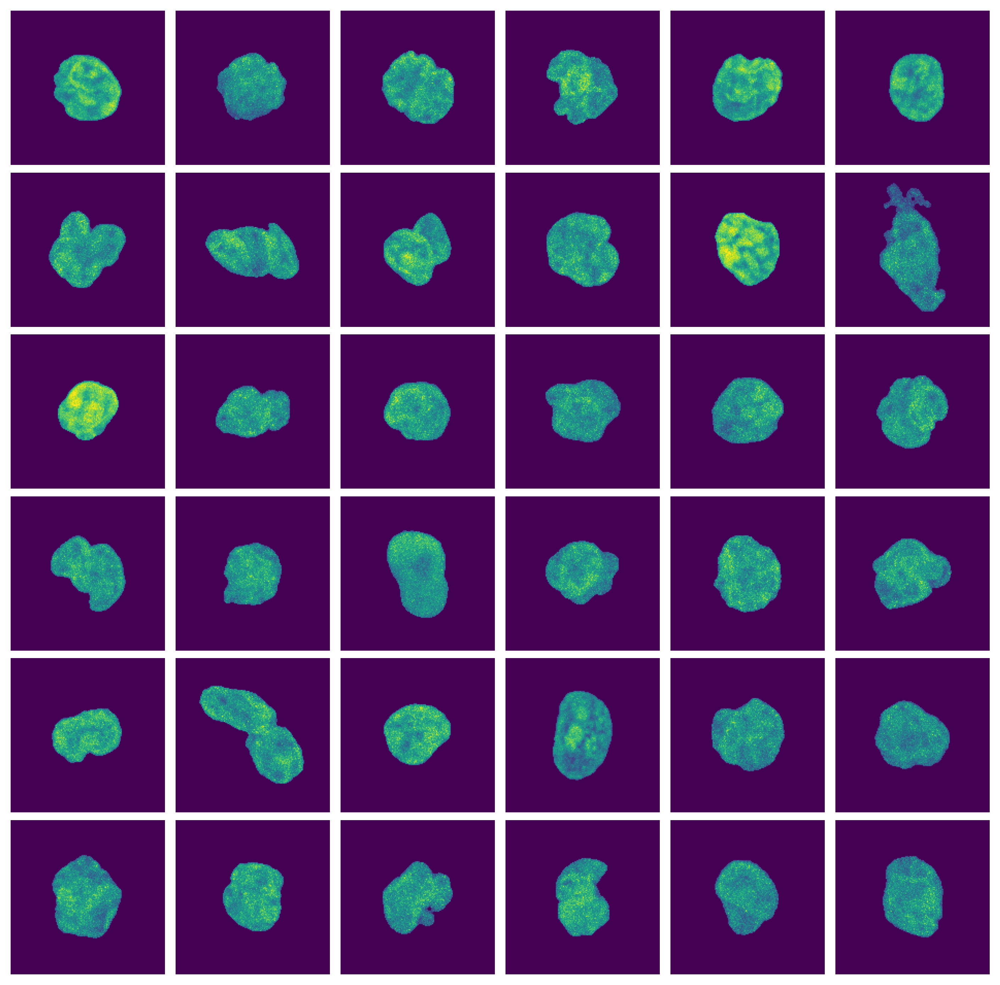

<IPython.core.display.Javascript object>

In [33]:
fig_rep1_hn, ax_rep1_hn = plot_montage(
    sampled_hn_rep1_images, pad_size=150, mask_nuclei=True
)

---

###  Dataset 2

#### Meningioma population

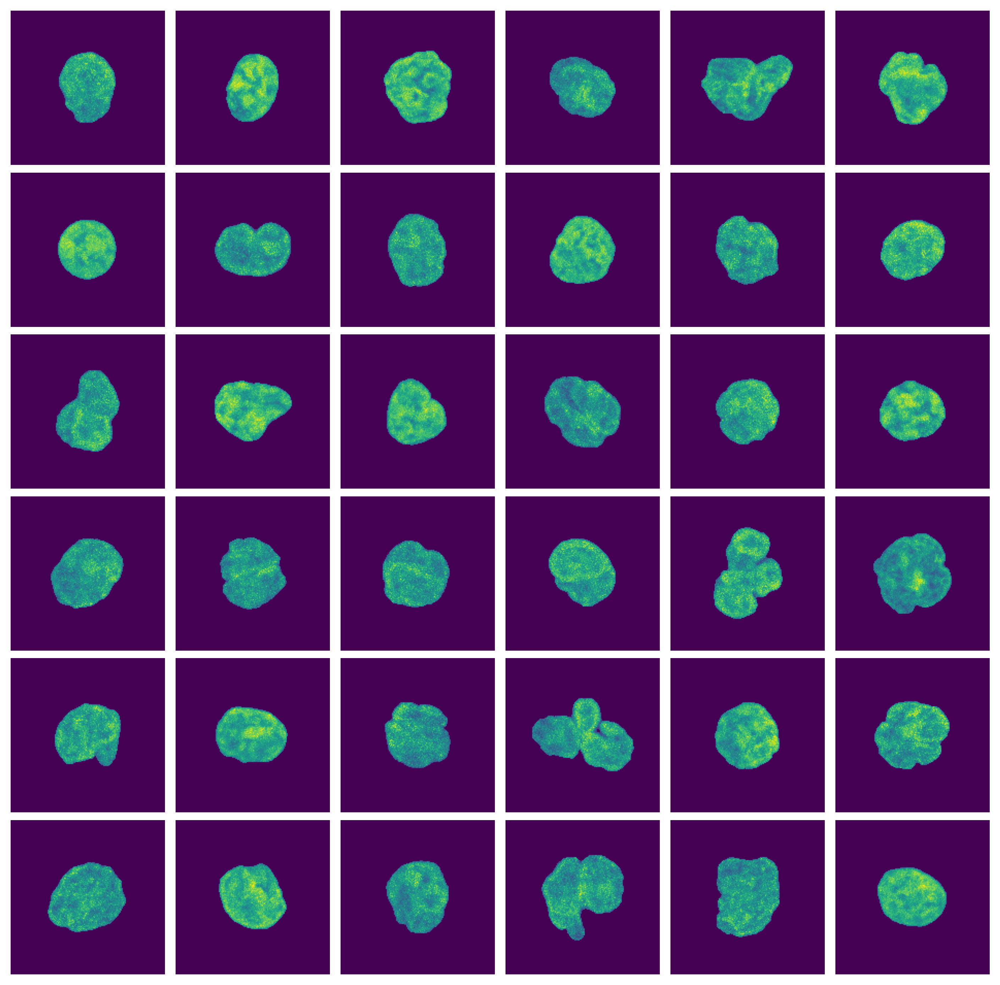

<IPython.core.display.Javascript object>

In [34]:
fig_rep2_mg, ax_rep2_mg = plot_montage(
    sampled_mg_rep2_images, pad_size=150, mask_nuclei=True
)

---

#### Glioma population

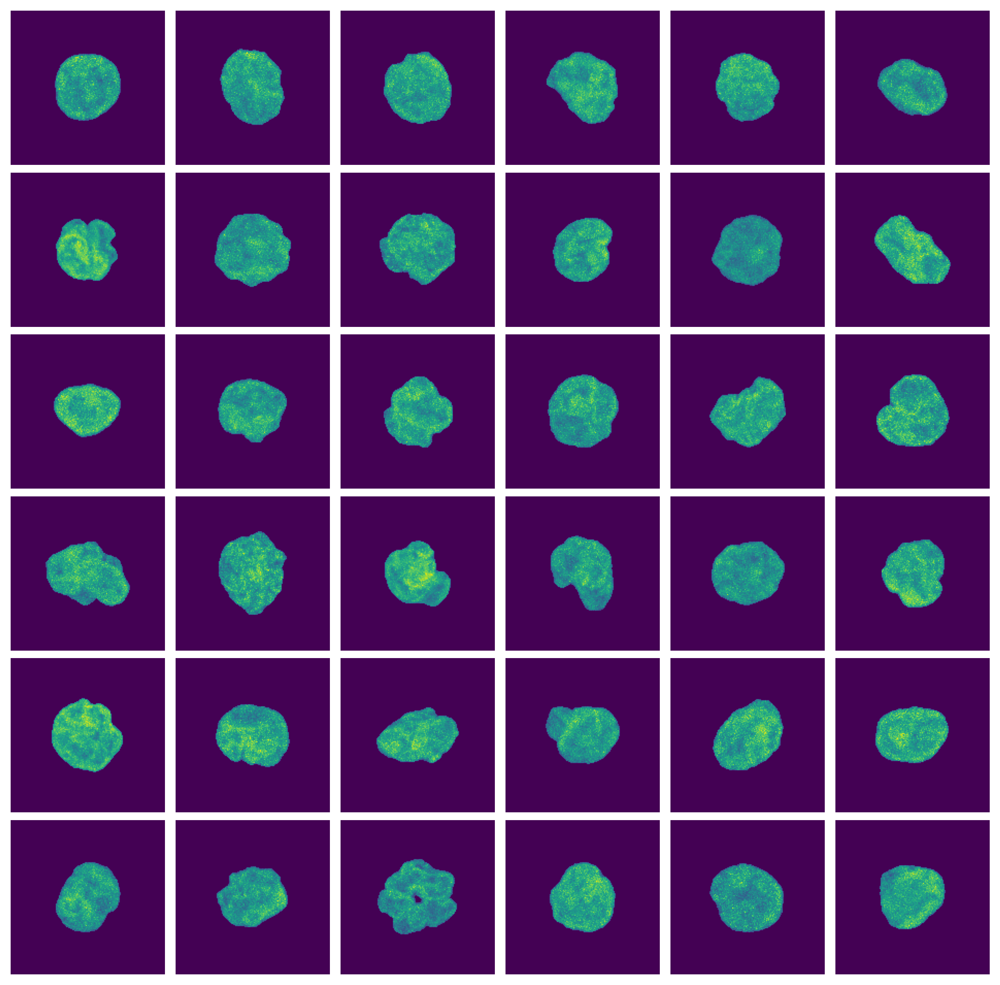

<IPython.core.display.Javascript object>

In [35]:
fig_rep2_gl, ax_rep2_gl = plot_montage(
    sampled_gl_rep2_images, pad_size=150, mask_nuclei=True
)

#### Head & Neck population

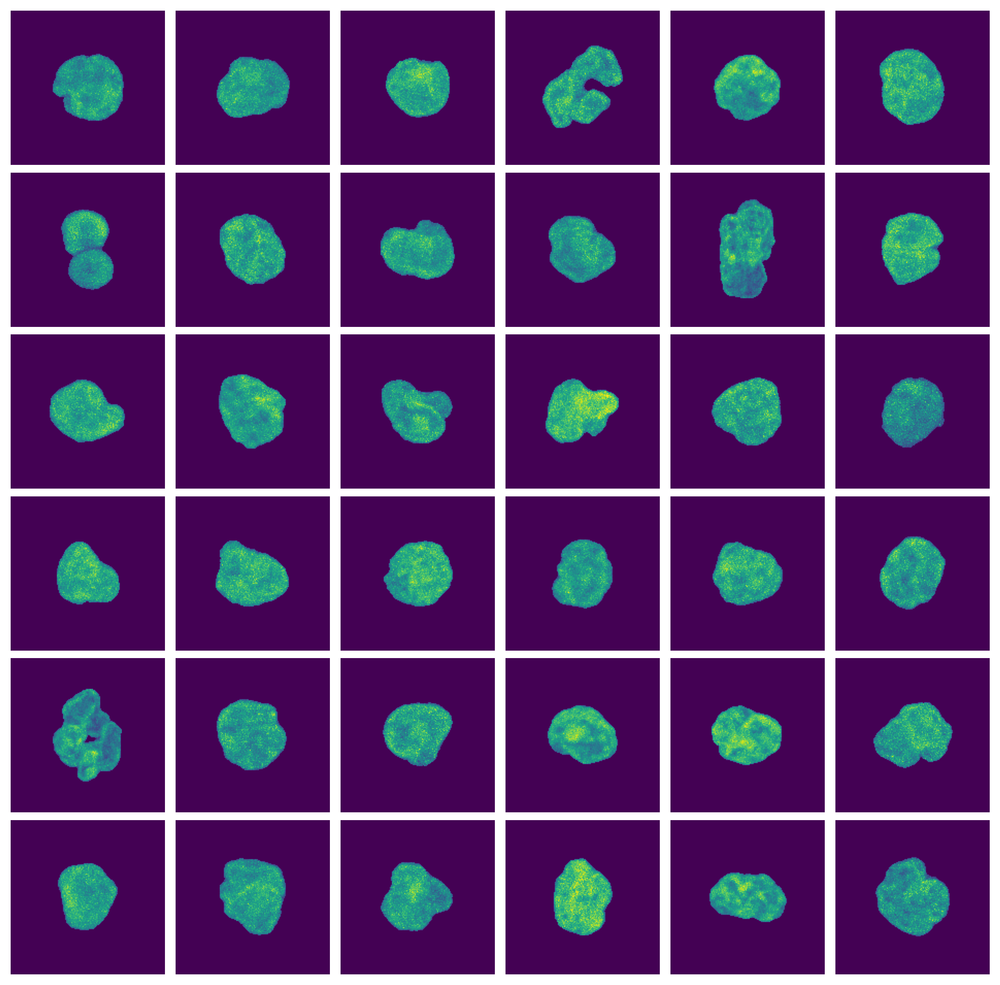

<IPython.core.display.Javascript object>

In [36]:
fig_rep2_hn, ax_rep2_hn = plot_montage(
    sampled_hn_rep2_images, pad_size=150, mask_nuclei=True
)

---

### 3b. Parametric analysis captures large-scale differences between control and cancer population

The montages above indicate the large-scale differences between the control and cancer population, which are also reflected in the extracted chromatic features as shown by the separation of the classes in a tSNE plot and by the high classification performance of random forest classifier as seen below.

In [37]:
set(list(chrometric_rep2_data.columns)) - set(list(chrometric_rep1_data.columns))

{'moments_central-3-2',
 'moments_hu-6',
 'moments_normalized-2-3',
 'weighted_moments_hu-1',
 'weighted_moments_hu-2',
 'weighted_moments_hu-3',
 'weighted_moments_hu-4',
 'weighted_moments_normalized-2-2',
 'weighted_moments_normalized-3-2'}

<IPython.core.display.Javascript object>

In [38]:
chrometric_rep1_embs = get_tsne_embs(chrometric_rep1_data)
chrometric_rep1_embs["cancer"] = rep1_cancer_labels
chrometric_rep1_embs["sample"] = rep1_sample_labels

chrometric_rep2_embs = get_tsne_embs(chrometric_rep2_data)
chrometric_rep2_embs["cancer"] = rep2_cancer_labels
chrometric_rep2_embs["sample"] = rep2_sample_labels

/home/paysan_d/miniconda3/envs/icp/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
/home/paysan_d/miniconda3/envs/icp/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [39]:
chrometric_embs = get_tsne_embs(chrometric_data)
chrometric_embs["cancer"] = cancer_labels
chrometric_embs["sample"] = sample_labels
chrometric_embs["replicate"] = rep_labels

/home/paysan_d/miniconda3/envs/icp/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

#### Dataset 1

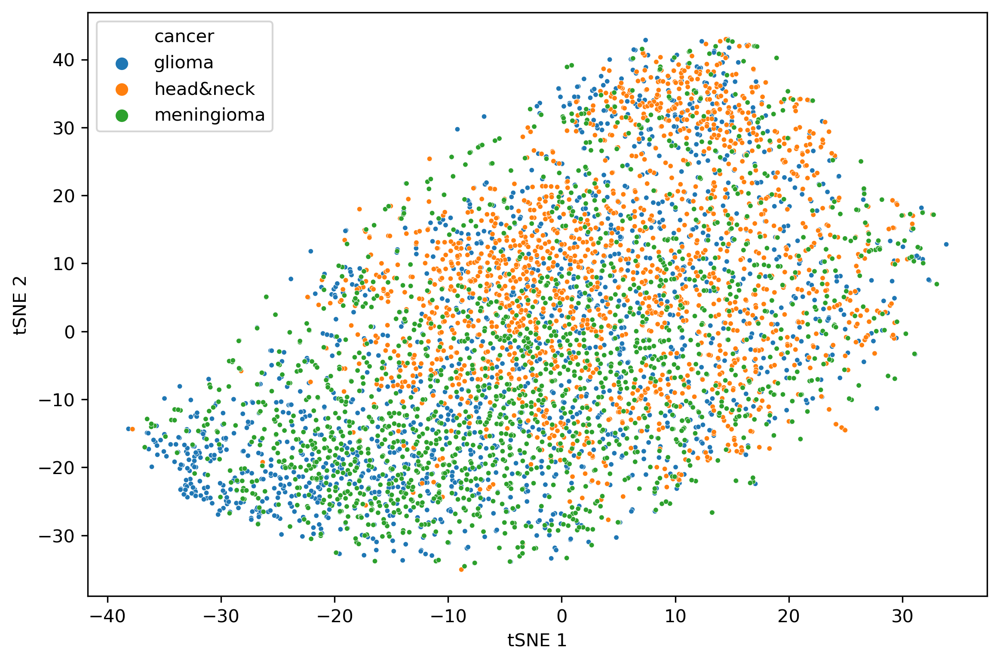

<IPython.core.display.Javascript object>

In [40]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_rep1_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="cancer",
    hue_order=np.unique(chrometric_rep1_embs.cancer),
    ax=ax,
    s=8,
    marker="o",
)
plt.show()

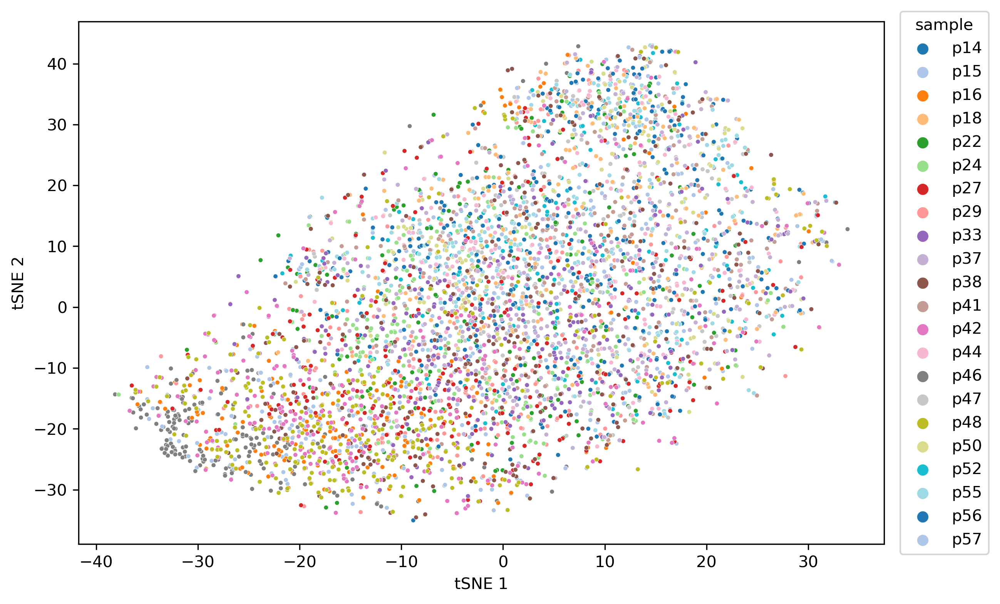

<IPython.core.display.Javascript object>

In [41]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_rep1_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="sample",
    hue_order=np.unique(chrometric_rep1_embs.loc[:, "sample"]),
    ax=ax,
    s=8,
    marker="o",
    palette="tab20",
)
plt.legend(
    bbox_to_anchor=(1.02, 0.5), loc="center left", borderaxespad=0, title="sample"
)
plt.show()

To quantify the separability of the two conditions we perform a 10-fold stratified cross-validation analysis using a RandomForest classifier. The classifier provides a simple non-linear classification model which also yields an importance measure for the individual chrometric features indicating which ones are most different between the two populations.

In [42]:
rfc = RandomForestClassifier(
    n_estimators=500, n_jobs=10, random_state=seed, class_weight="balanced"
)

<IPython.core.display.Javascript object>

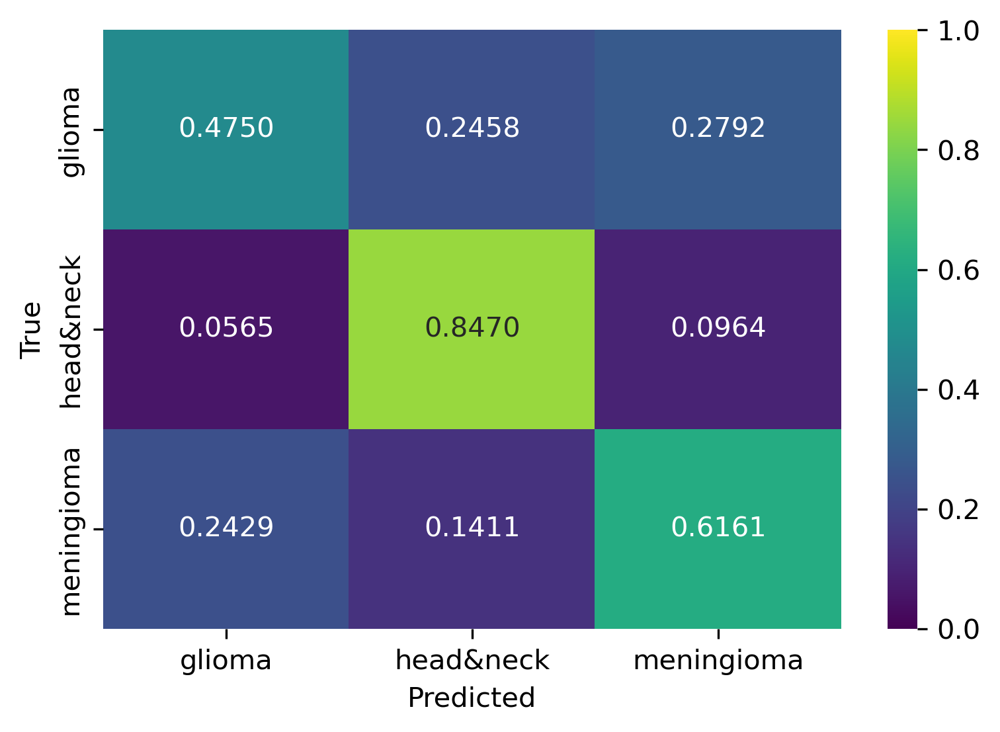

<IPython.core.display.Javascript object>

In [43]:
fig, ax = plot_cv_conf_mtx(
    estimator=rfc,
    features=chrometric_rep1_data,
    labels=rep1_cancer_labels,
    scale_features=True,
    n_folds=10,
    cmap="viridis",
    figsize=[6, 4],
    seed=1234,
    order=np.unique(rep1_cancer_labels)
)


The classifier is able to accurately distinguish nuclei from the different cancer populations and it does particularly well on samples from the head&neck cancer population.

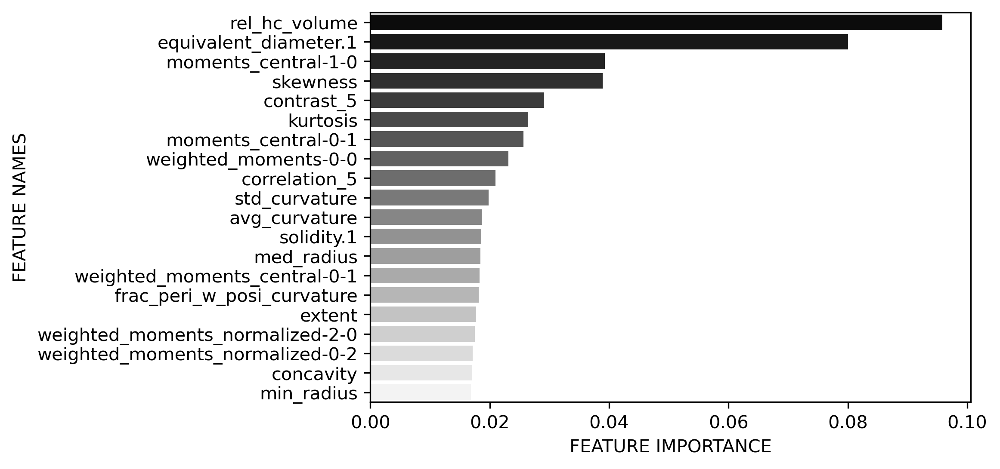

<IPython.core.display.Javascript object>

In [44]:
fig, ax = plot_feature_importance_for_estimator(
    rfc,
    chrometric_rep1_data,
    rep1_cancer_labels,
    scale_features=True,
    cmap="gray",
    figsize=[6, 4],
)

The analysis suggests that the heterochromatin content as well as the size of the nucleus are most discriminative between the different cancer populations.

---

#### Dataset 2

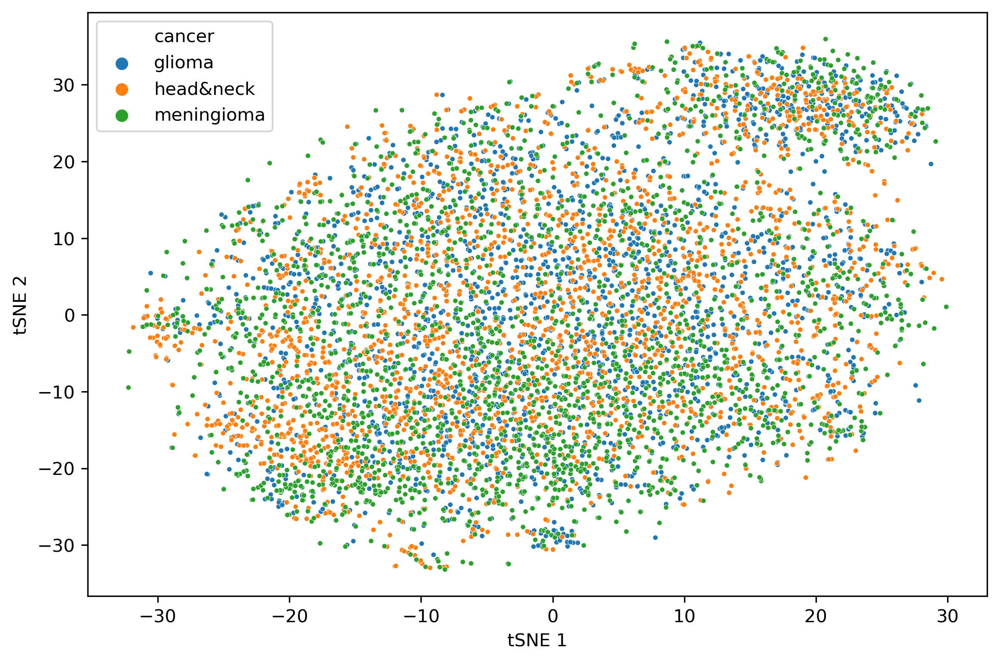

<IPython.core.display.Javascript object>

In [45]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_rep2_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="cancer",
    hue_order=np.unique(chrometric_rep2_embs.loc[:, "cancer"]),
    ax=ax,
    s=8,
    marker="o",
)

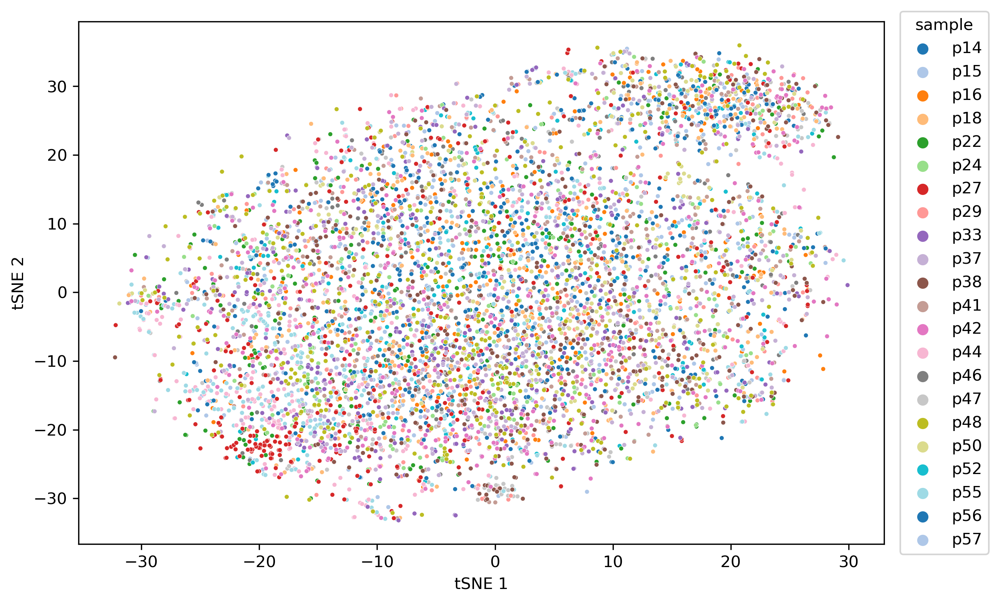

<IPython.core.display.Javascript object>

In [46]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_rep2_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="sample",
    hue_order=np.unique(chrometric_rep2_embs.loc[:, "sample"]),
    ax=ax,
    s=8,
    marker="o",
    palette="tab20",
)
plt.legend(
    bbox_to_anchor=(1.02, 0.5), loc="center left", borderaxespad=0, title="sample"
)
plt.show()

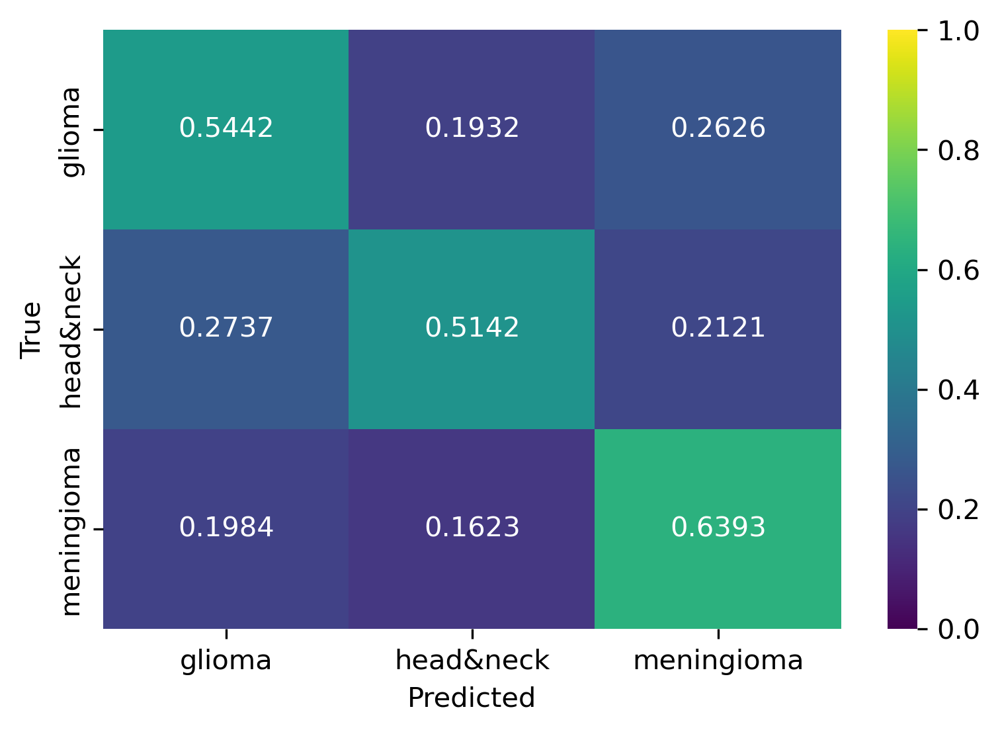

<IPython.core.display.Javascript object>

In [47]:
fig, ax = plot_cv_conf_mtx(
    estimator=rfc,
    features=chrometric_rep2_data,
    labels=rep2_cancer_labels,
    scale_features=True,
    n_folds=10,
    cmap="viridis",
    figsize=[6, 4],
    seed=1234,
    order=np.unique(rep2_cancer_labels)
)


The second data set which is treated as a second biological replicate does not align with the previous findings. In fact, in that sample the head&neck cancer population is the one the classifier performs worst on. This suggests that there are significant batch effects between the two replicates.

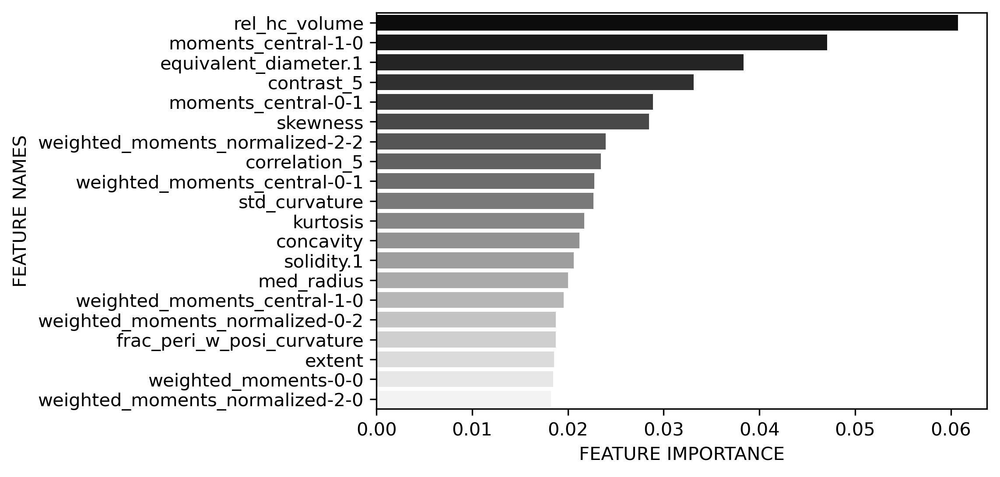

<IPython.core.display.Javascript object>

In [48]:
fig, ax = plot_feature_importance_for_estimator(
    rfc,
    chrometric_rep2_data,
    rep2_cancer_labels,
    scale_features=True,
    cmap="gray",
    figsize=[6, 4],
)

While the performance is substantially worse the most discriminative features are still the heterochromatin content and size related features in addtion to some intensity features.

---

#### Combined data set

We now look at the combined data set to identify the batch effects. Note that the first dataset in total contains 5,040 nuclei, whereas the second dataset (replicate) is substantially larger containing 7,002 nuclei.

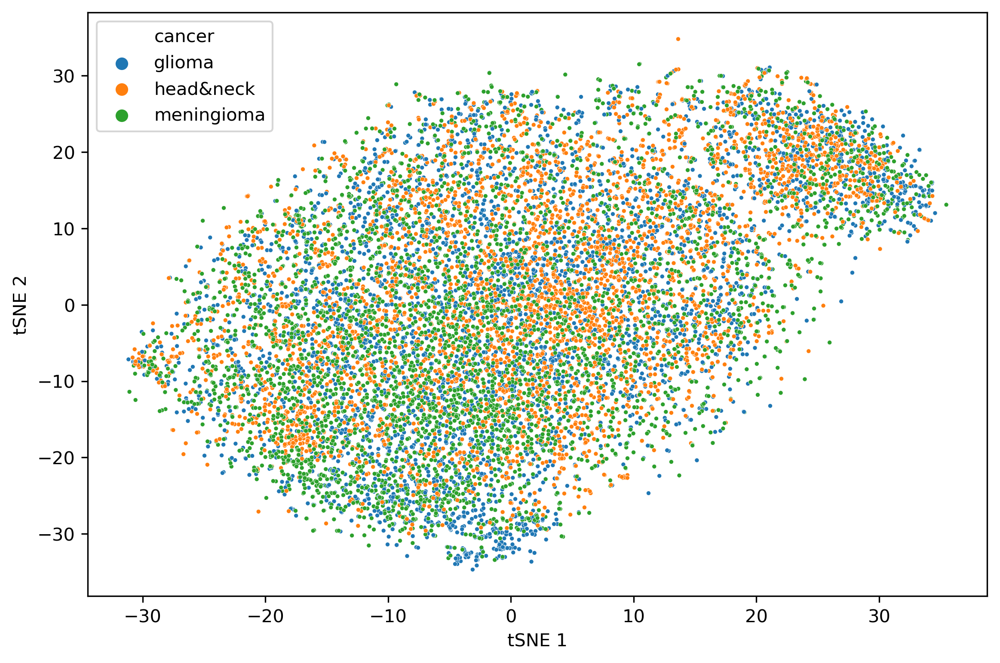

<IPython.core.display.Javascript object>

In [49]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="cancer",
    hue_order=np.unique(chrometric_embs.cancer),
    ax=ax,
    s=6,
    marker="o",
)

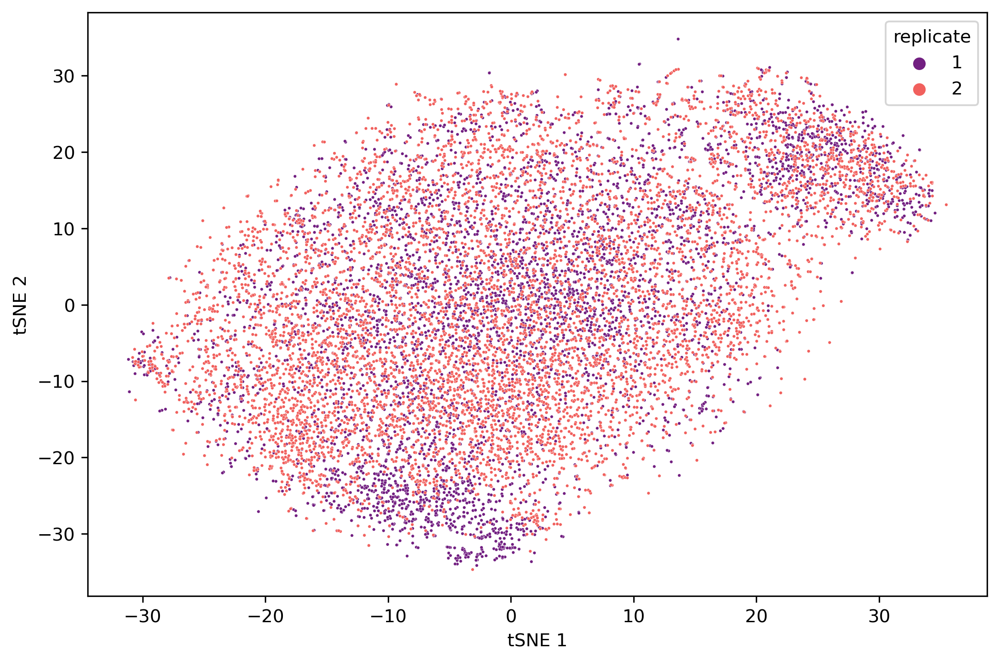

<IPython.core.display.Javascript object>

In [50]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="replicate",
    hue_order=["1", "2"],
    ax=ax,
    s=3,
    marker="o",
    palette="magma",
)

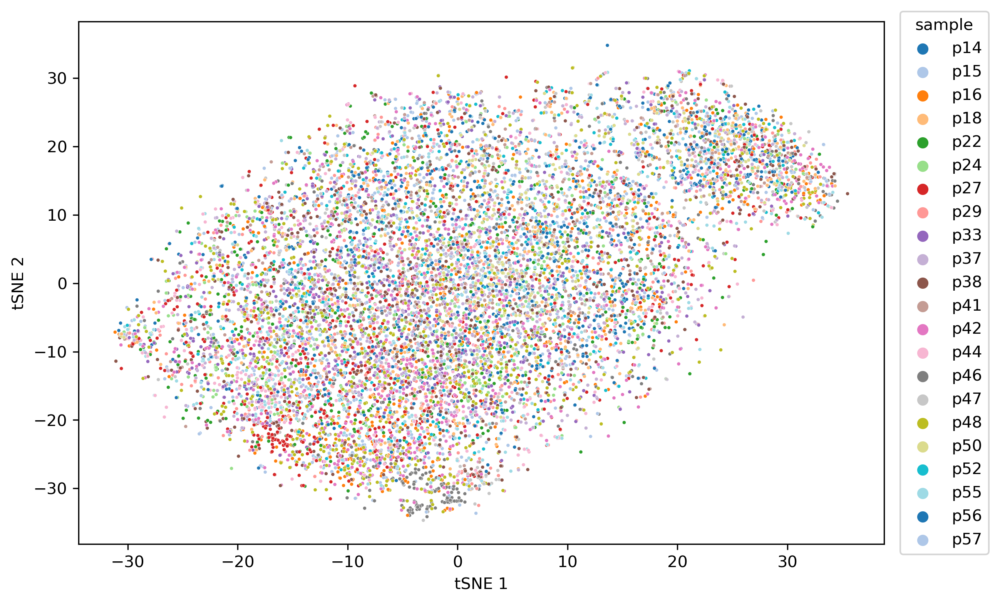

<IPython.core.display.Javascript object>

In [51]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="sample",
    hue_order=np.unique(chrometric_embs.loc[:, "sample"]),
    ax=ax,
    s=5,
    marker="o",
    palette="tab20",
)
plt.legend(
    bbox_to_anchor=(1.02, 0.5), loc="center left", borderaxespad=0, title="sample"
)
plt.show()

The above plot clearly shows that there is a significant subpopulation of the first replicate that clusters away from the dataset of the second replicate.

#### Assessment of batch effects

To understand what contributes to the batch effects and how strong those are we first assess the discriminability of the two replicates using a RandomForest classifier.

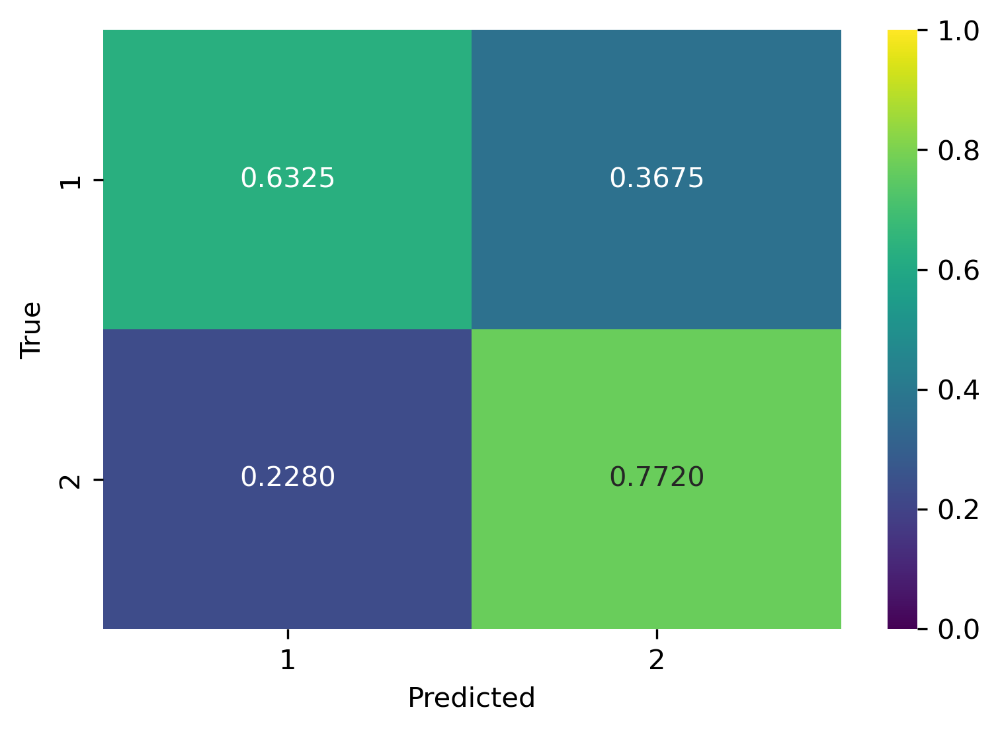

<IPython.core.display.Javascript object>

In [52]:
res_chrometric_rep_data, res_rep_labels = RandomUnderSampler(random_state=1234).fit_resample(chrometric_data, rep_labels)

fig, ax = plot_cv_conf_mtx(
    estimator=rfc,
    features=res_chrometric_rep_data,
    labels=res_rep_labels,
    scale_features=True,
    n_folds=10,
    cmap="viridis",
    figsize=[6, 4],
    seed=1234,
    order=np.unique(res_rep_labels)
)


We observe that the samples of replicate two can be well distinguished from the ones of the first replicat, which validates the existance of fairly strong batch effects.

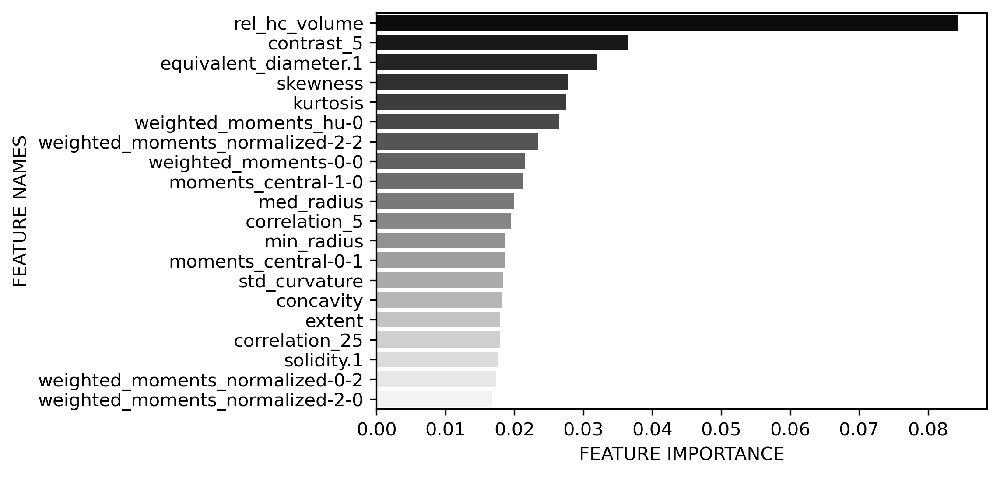

<IPython.core.display.Javascript object>

In [53]:
fig, ax = plot_feature_importance_for_estimator(
    rfc,
    res_chrometric_rep_data,
    res_rep_labels,
    scale_features=True,
    cmap="gray",
    figsize=[6, 4],
)

We observe that the most signficant differences between the batches are in great agreement with the features that we observed to be different between the different cancer types. The plot below shows the relative heterochromatin volume for each cancer type and replicate.

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

2_head&neck vs. 2_meningioma: t-test independent samples, P_val:2.669e-02 t=2.217e+00
1_glioma vs. 1_head&neck: t-test independent samples, P_val:1.953e-145 t=-2.700e+01
1_head&neck vs. 1_meningioma: t-test independent samples, P_val:7.197e-187 t=3.110e+01
2_glioma vs. 2_head&neck: t-test independent samples, P_val:9.903e-01 t=-1.217e-02
2_glioma vs. 2_meningioma: t-test independent samples, P_val:1.165e-02 t=2.524e+00
1_glioma vs. 1_meningioma: t-test independent samples, P_val:5.173e-01 t=6.476e-01
1_meningioma vs. 2_meningioma: t-test independent samples, P_val:1.130e-01 t=-1.585e+00
1_glioma vs. 2_glioma: t-test independent samples, P_val:7.482e-03 t=-2.676e+00
1_head&neck vs. 2_head&neck: t-test independent samples, P_val:4.545e-149 t=2.714e+01


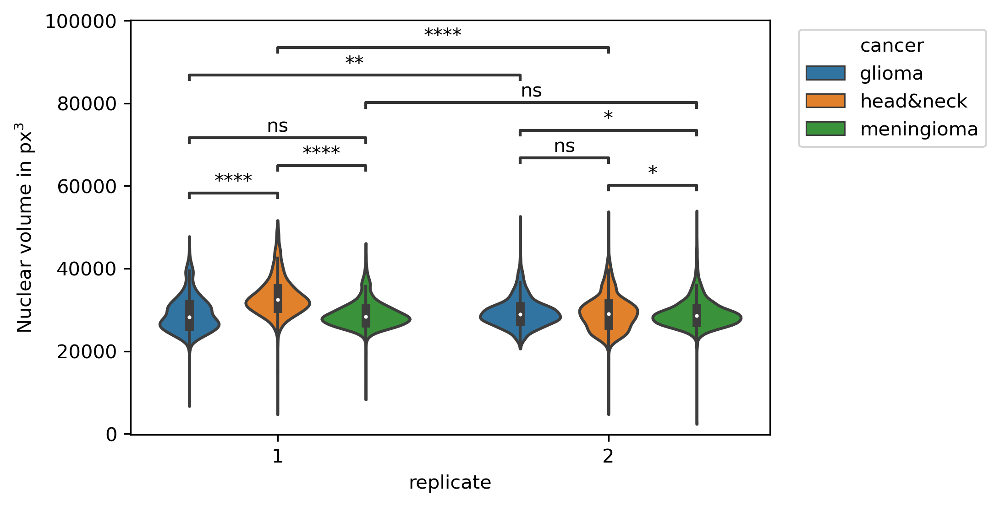

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

2_head&neck vs. 2_meningioma: t-test independent samples, P_val:4.565e-88 t=-2.032e+01
1_glioma vs. 1_head&neck: t-test independent samples, P_val:5.212e-129 t=-2.526e+01
1_head&neck vs. 1_meningioma: t-test independent samples, P_val:6.069e-288 t=4.012e+01
2_glioma vs. 2_head&neck: t-test independent samples, P_val:1.816e-02 t=2.363e+00
2_glioma vs. 2_meningioma: t-test independent samples, P_val:4.310e-102 t=-2.199e+01
1_glioma vs. 1_meningioma: t-test independent samples, P_val:1.723e-06 t=4.792e+00
1_meningioma vs. 2_meningioma: t-test independent samples, P_val:6.629e-217 t=-3.348e+01
1_glioma vs. 2_glioma: t-test independent samples, P_val:1.796e-13 t=-7.389e+00
1_head&neck vs. 2_head&neck: t-test independent samples, P_val:3.581e-155 t=2.775e+01


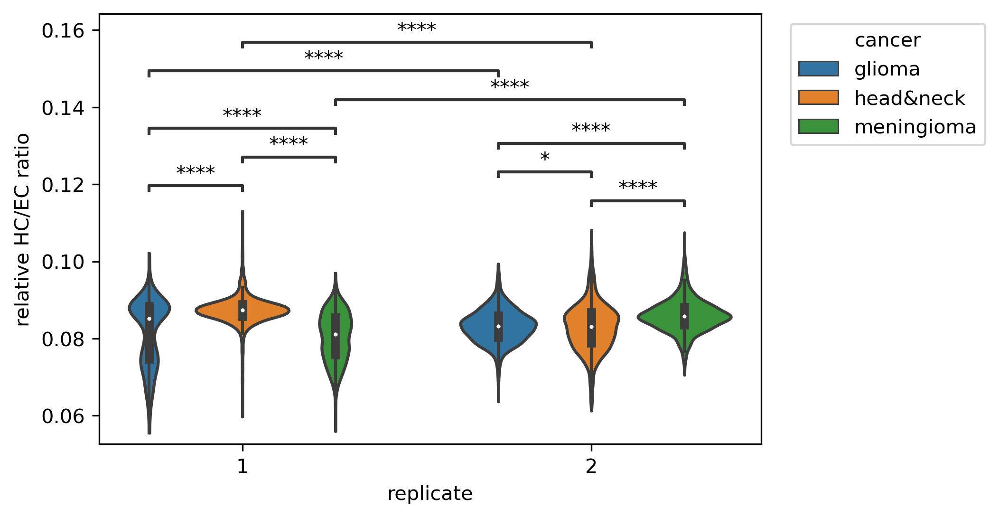

<IPython.core.display.Javascript object>

In [54]:
markers = ["nuclear_volume", "hc_ec_ratio_3d"]
marker_labels = [
    r"Nuclear volume in px$^3$",
    "relative HC/EC ratio",
]
for i in range(len(markers)):
    fig, ax = plot_marker_distribution(
        data=data,
        figsize=[6, 4],
        marker=markers[i],
        label_col="rep",
        hue="cancer",
        hue_order=["glioma", "head&neck", "meningioma"],
        box_pairs=[
            (("1", "meningioma"), ("2", "meningioma")),
            (("1", "glioma"), ("2", "glioma")),
            (("1", "head&neck"), ("2", "head&neck")),
            (("1", "glioma"), ("1", "head&neck")),
            (("1", "glioma"), ("1", "meningioma")),
            (("1", "head&neck"), ("1", "meningioma")),
            (("2", "glioma"), ("2", "head&neck")),
            (("2", "glioma"), ("2", "meningioma")),
            (("2", "head&neck"), ("2", "meningioma")),
        ],
        stat_annot="star",
        quantiles=None,
        cut=0,
        plot_type="violin",
    )
    ax.set_xlabel("replicate")
    ax.set_ylabel(marker_labels[i])
    plt.legend(title="cancer", loc="upper left", bbox_to_anchor=(1.03, 1))
    plt.show()
    plt.close()

We observe quite significant differences between the individual replicates and more importantly the trends are also dissimilar.

To identify the samples that constitute to those batch effects, we will first identify those samples of the first replicate that cluster away from the samples of the second replicate. To this end, we will fit a simple RandomForest classifier model on the task of discriminating between the different replicates based on the chrometric features. Thereby, we do not split the data into training and testing but simply use the output prediction probabilities as a measure of dissimilarity of the samples between the replicates. Samples with a prediction probability of larger than 0.95 or smaller than 0.05 are considered to be the ones contributing to the batch effects.
A tSNE plot validates the applicability of that approach.

In [55]:
rf = RandomForestClassifier(n_estimators=100, random_state=seed)
np.random.seed(seed)
sample_idc = np.random.choice(
    list(range(len(res_rep_labels))), size=int(0.9 * len(res_rep_labels))
)
rf.fit(res_chrometric_rep_data.iloc[sample_idc], res_rep_labels[sample_idc])
chrometric_embs["rep_pred_probs"] = np.array(rf.predict_proba(chrometric_data))[:, 0]

<IPython.core.display.Javascript object>

In [56]:
threshold = 0.90
chrometric_embs["replicate_specific"] = np.logical_or(
    (np.array(chrometric_embs.rep_pred_probs) > threshold)
    * (np.array(chrometric_embs.replicate) == "1"),
    (np.array(chrometric_embs.rep_pred_probs) < 1 - threshold)
    * (np.array(chrometric_embs.replicate) == "2"),
)

<IPython.core.display.Javascript object>

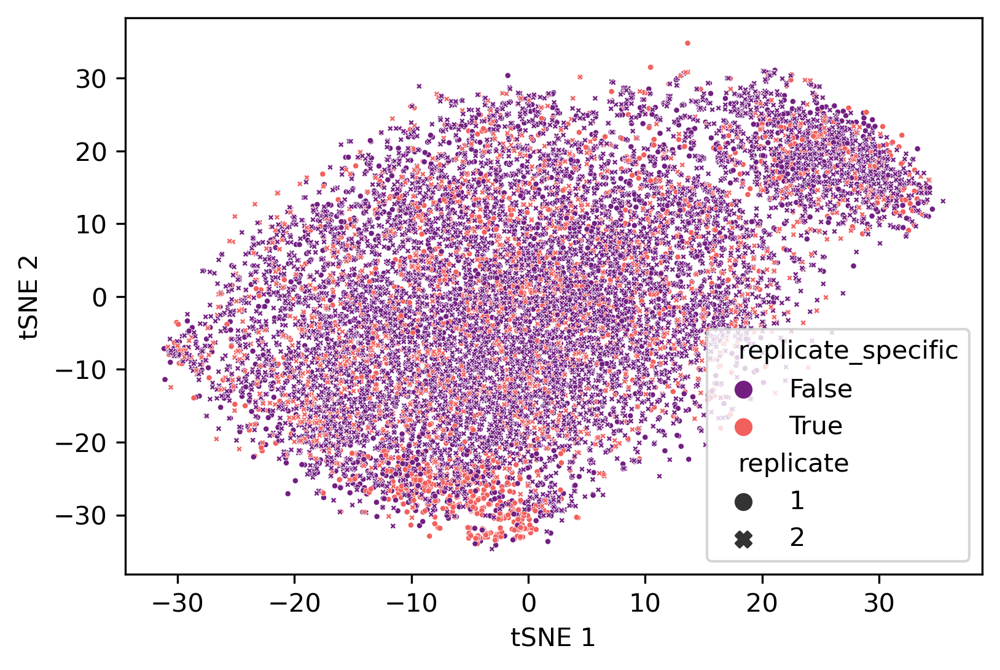

<IPython.core.display.Javascript object>

In [57]:
fig, ax = plt.subplots(figsize=[6, 4])
ax = sns.scatterplot(
    data=chrometric_embs,
    x="tSNE 1",
    y="tSNE 2",
    style="replicate",
    hue="replicate_specific",
    s=5,
    palette="magma",
)

The vast majority of the samples identified as specific for an individual replicate come from replicate 1.

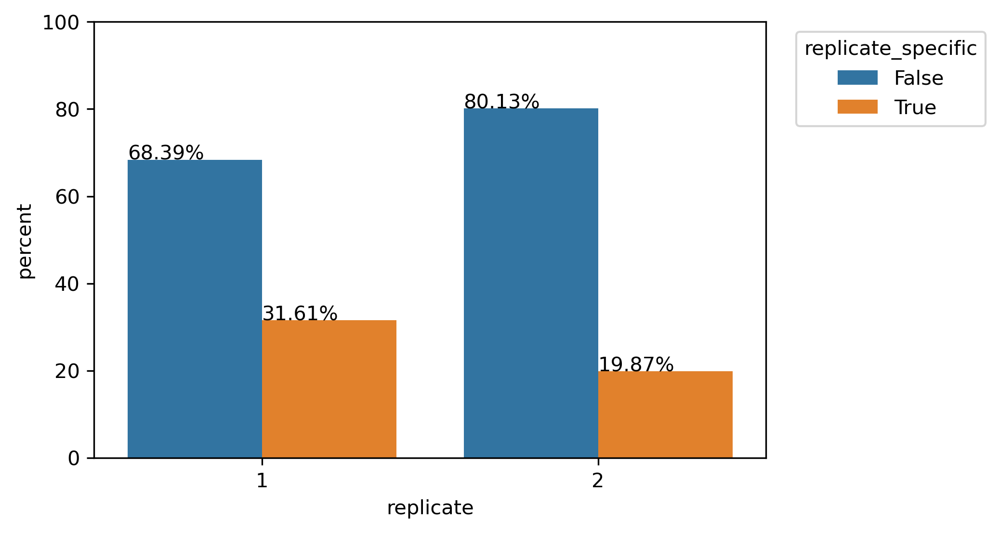

<IPython.core.display.Javascript object>

In [58]:
x, y = "replicate", "replicate_specific"

tmp = chrometric_embs.groupby(x)[y].value_counts(normalize=True)
tmp = tmp.mul(100)
tmp = tmp.rename("percent").reset_index()

fig, ax = plt.subplots(figsize=[6, 4])
ax = sns.barplot(x=x, y="percent", hue=y, data=tmp, ax=ax)
ax.set_ylim(0, 100)

for p in ax.patches:
    txt = str(p.get_height().round(2)) + "%"
    txt_x = p.get_x()
    txt_y = p.get_height()
    ax.text(txt_x, txt_y, txt)
plt.legend(title="replicate_specific", loc="upper left", bbox_to_anchor=(1.03, 1))

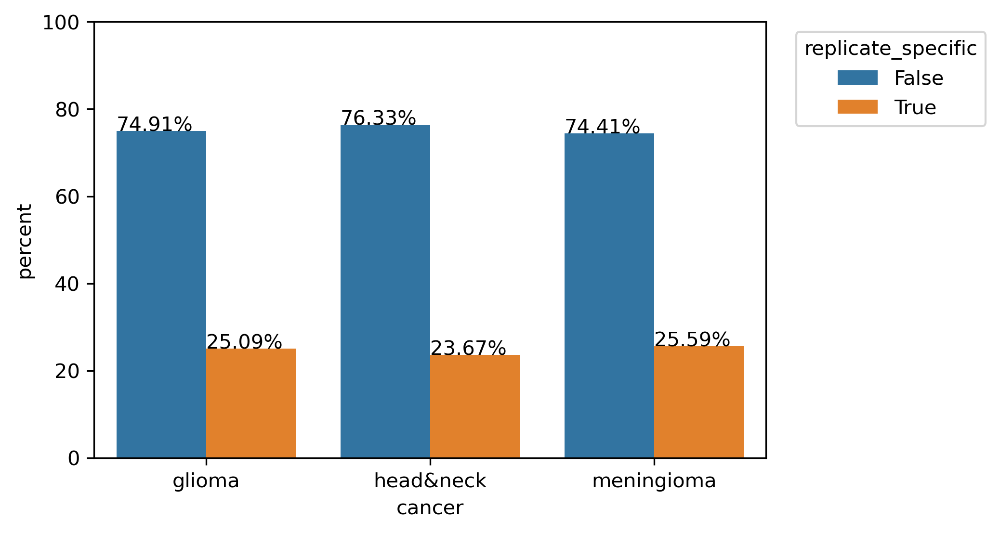

<IPython.core.display.Javascript object>

In [59]:
x, y = "cancer", "replicate_specific"

tmp = chrometric_embs.groupby(x)[y].value_counts(normalize=True)
tmp = tmp.mul(100)
tmp = tmp.rename("percent").reset_index()

fig, ax = plt.subplots(figsize=[6, 4])
ax = sns.barplot(x=x, y="percent", hue=y, data=tmp, ax=ax)
ax.set_ylim(0, 100)

for p in ax.patches:
    txt = str(p.get_height().round(2)) + "%"
    txt_x = p.get_x()
    txt_y = p.get_height()
    ax.text(txt_x, txt_y, txt)
plt.legend(title="replicate_specific", loc="upper left", bbox_to_anchor=(1.03, 1))

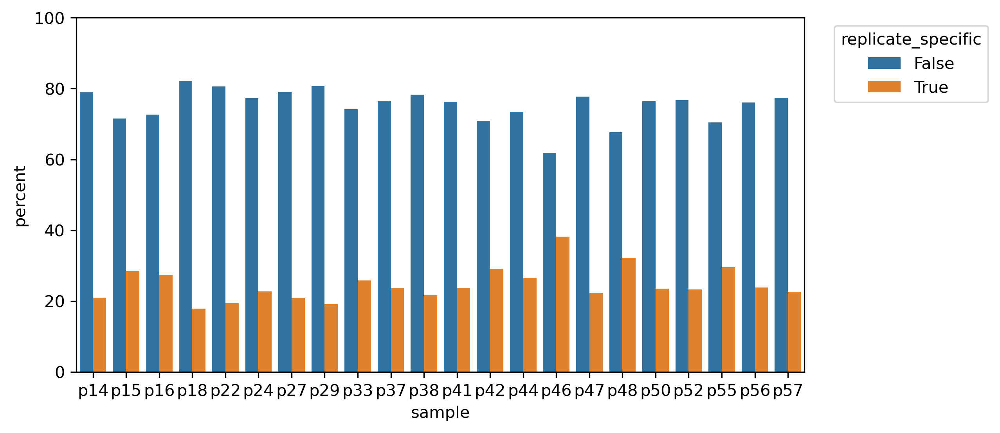

<IPython.core.display.Javascript object>

In [60]:
x, y = "sample", "replicate_specific"

tmp = chrometric_embs.groupby(x)[y].value_counts(normalize=True)
tmp = tmp.mul(100)
tmp = tmp.rename("percent").reset_index()

fig, ax = plt.subplots(figsize=[8,4])
ax = sns.barplot(x=x, y="percent", hue=y, data=tmp, ax=ax)
ax.set_ylim(0, 100)
plt.legend(title="replicate_specific", loc="upper left", bbox_to_anchor=(1.03, 1))


In summary, there seems to be an enrichment of replicate-specific samples in the first replicate. Additionaly, we see a slight enrichment of Glioma patient samples in particular P46, P52 and P57 to have a slightly higher number of samples that are identified to be specific for the individual replicate compared to the other.

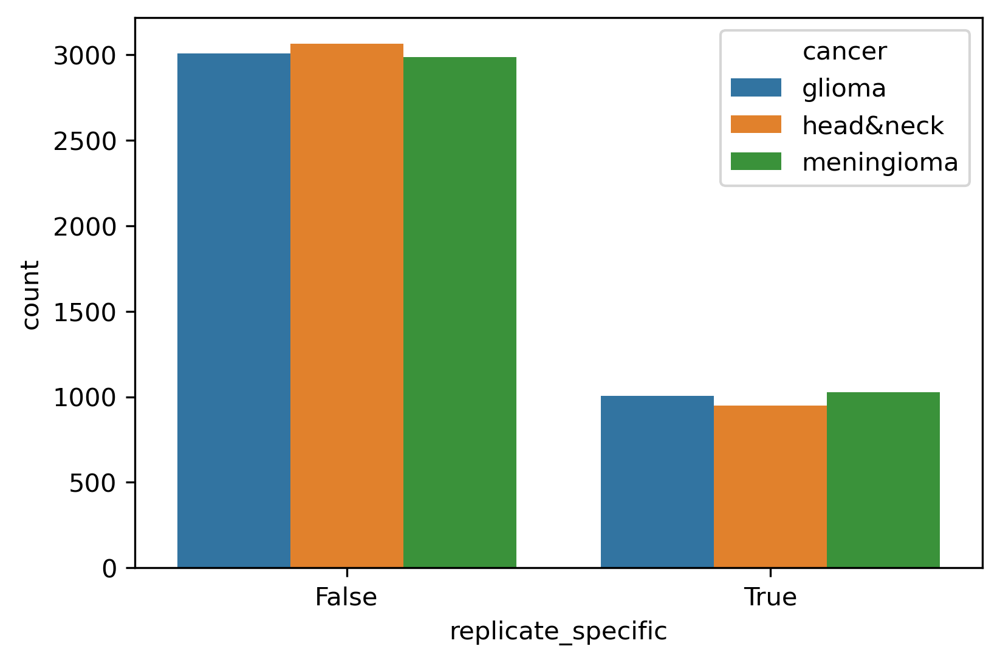

<IPython.core.display.Javascript object>

In [61]:
fig, ax = plt.subplots(figsize=[6, 4])
ax = sns.countplot(data=chrometric_embs, x="replicate_specific", hue="cancer")

The results of the analysis are in great agreement with those of the replicate-specific datasets.

---

### 3c. Nuclear chromatin biomarkers identifying cancer populations

While the previously shown feature importance plots already suggest a number of candidate chrometric biomarkers that capture the differences of the nuclear phenotypes in health and cancer, we run marker screen by testing for differential distributions of the individual chrometric features between the control and cancer population. To this end, we apply a t-test to test for difference in the means and adjust for multiple testing using the Benjamini-Hochberg procedure.

#### Data set 1

In [62]:
marker_screen_rep1_results = find_markers(chrometric_rep1_data, rep1_cancer_labels)

Run marker screen: 100%|██████████| 3/3 [00:00<00:00, 17.59it/s]


<IPython.core.display.Javascript object>

In [63]:
marker_screen_rep1_results.loc[marker_screen_rep1_results.label == "glioma"].head(10)

,label,marker,fc,abs_delta_fc,pval,pval_adjust
49,glioma,equivalent_diameter.1,0.977176,0.022824,1.388479e-52,2.499262e-51
17,glioma,skewness,2.236967,1.236967,1.776683e-23,1.251403e-22
52,glioma,rel_hc_volume,0.975314,0.024686,2.585729e-21,1.745367e-20
16,glioma,kurtosis,1.174123,0.174123,7.945348e-11,3.139381e-10
22,glioma,correlation_5,1.015016,0.015016,1.401245e-09,5.159130e-09
53,glioma,rdp_1,1.256436,0.256436,5.352840e-09,1.885131e-08
8,glioma,std_curvature,0.964708,0.035292,3.664236e-06,1.120012e-05
2,glioma,smallest_largest_calliper,1.014045,0.014045,1.088178e-05,3.205179e-05
15,glioma,frac_peri_w_posi_curvature,1.007811,0.007811,1.889414e-05,5.187883e-05
0,glioma,min_calliper,1.011366,0.011366,4.447990e-05,1.200957e-04


<IPython.core.display.Javascript object>

In [64]:
marker_screen_rep1_results.loc[marker_screen_rep1_results.label == "head&neck"].head(10)

,label,marker,fc,abs_delta_fc,pval,pval_adjust
52,head&neck,rel_hc_volume,1.071506,0.071506,0.000000e+00,0.000000e+00
49,head&neck,equivalent_diameter.1,1.046391,0.046391,1.021575e-201,8.274754e-200
17,head&neck,skewness,-0.293819,1.293819,1.374128e-196,7.420289e-195
16,head&neck,kurtosis,0.627468,0.372532,5.622544e-98,2.277130e-96
8,head&neck,std_curvature,1.131924,0.131924,6.993183e-58,1.416120e-56
15,head&neck,frac_peri_w_posi_curvature,0.973906,0.026094,2.294488e-46,3.717070e-45
13,head&neck,num_prominant_pos_curv,1.117925,0.117925,1.245566e-39,1.834380e-38
10,head&neck,max_posi_curv,1.126423,0.126423,1.129498e-34,1.407528e-33
7,head&neck,avg_curvature,0.964620,0.035380,1.342165e-31,1.553077e-30
22,head&neck,correlation_5,0.973577,0.026423,1.890972e-28,1.914609e-27


<IPython.core.display.Javascript object>

In [65]:
marker_screen_rep1_results.loc[marker_screen_rep1_results.label == "meningioma"].head(
    10
)

,label,marker,fc,abs_delta_fc,pval,pval_adjust
52,meningioma,rel_hc_volume,0.955713,0.044287,1.309980e-90,4.244334e-89
49,meningioma,equivalent_diameter.1,0.977485,0.022515,3.213322e-67,8.675970e-66
17,meningioma,skewness,3.621840,2.621840,6.318745e-64,1.462338e-62
8,meningioma,std_curvature,0.912004,0.087996,1.298106e-36,1.752443e-35
7,meningioma,avg_curvature,1.031449,0.031449,3.324210e-30,3.590147e-29
16,meningioma,kurtosis,1.285606,0.285606,5.506966e-26,4.956270e-25
10,meningioma,max_posi_curv,0.916817,0.083183,8.178957e-26,6.973637e-25
13,meningioma,num_prominant_pos_curv,0.913547,0.086453,2.614040e-25,2.117372e-24
4,meningioma,med_radius,0.980477,0.019523,6.408010e-25,4.943322e-24
15,meningioma,frac_peri_w_posi_curvature,1.018648,0.018648,7.639655e-25,5.625564e-24


<IPython.core.display.Javascript object>

We find that the most significantly different features are a number of size features such as equivalent diameter and chromatin compaction and intesity features such as the relative heterochromatin volume and the skewness.

As a joint proxy to study the alterations in size, we focus at the nuclear volume, the variation in the shape by the concavity as well as the aspect ratio of the nucleus and the change in chromatin compaction by the relative heterochromatin to euchromatin ratio, additionally we observe differences in the curvature.

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:1.953e-145 t=-2.700e+01
head&neck vs. meningioma: t-test independent samples, P_val:7.197e-187 t=3.110e+01
glioma vs. meningioma: t-test independent samples, P_val:5.173e-01 t=6.476e-01


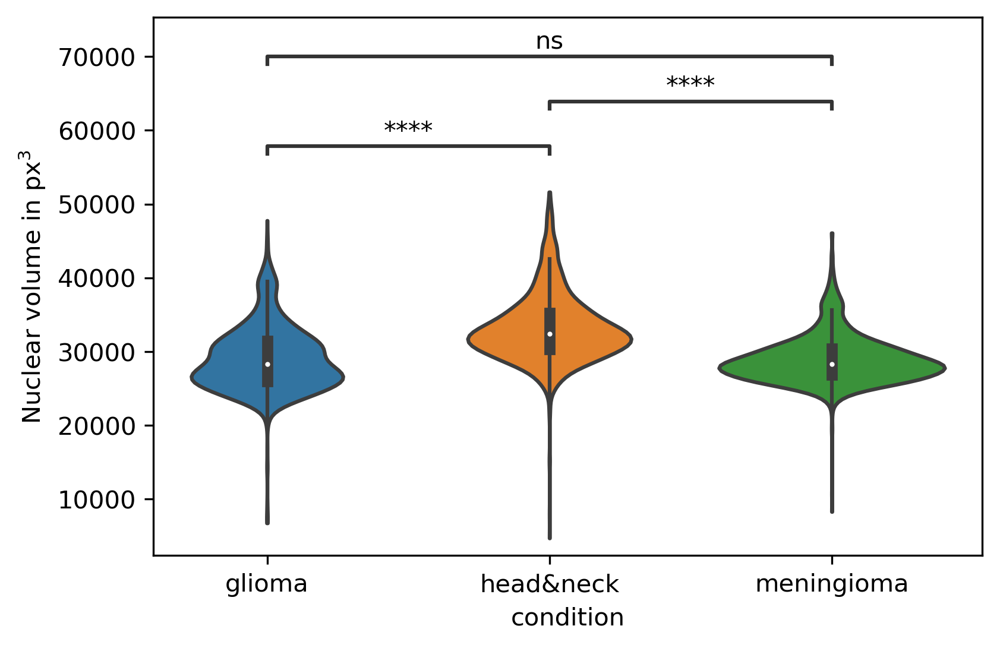

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:5.212e-129 t=-2.526e+01
head&neck vs. meningioma: t-test independent samples, P_val:6.069e-288 t=4.012e+01
glioma vs. meningioma: t-test independent samples, P_val:1.723e-06 t=4.792e+00


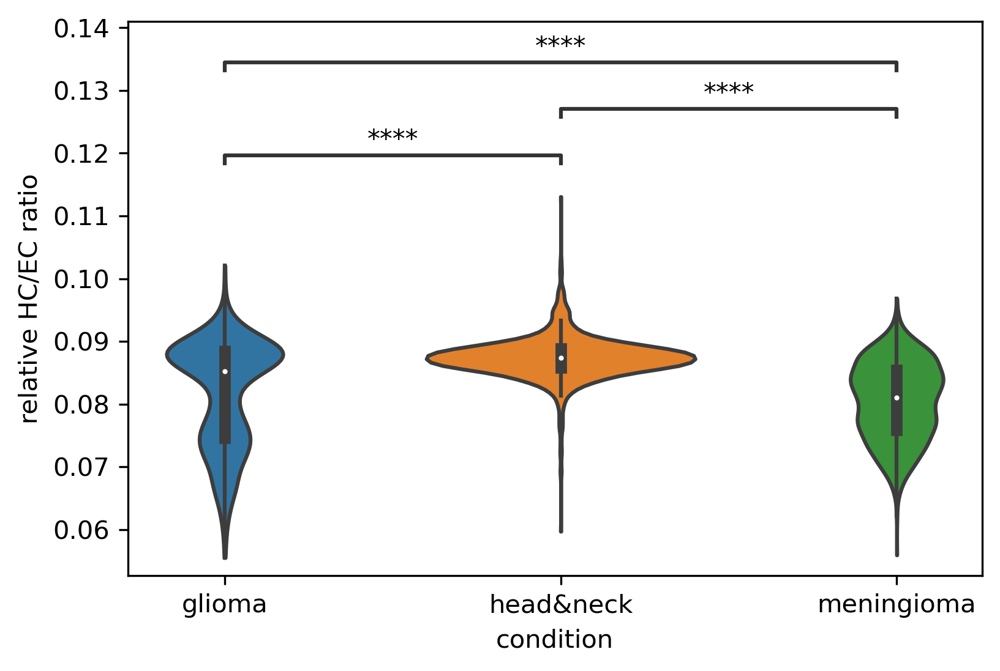

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:5.096e-14 t=-7.562e+00
head&neck vs. meningioma: t-test independent samples, P_val:6.696e-20 t=9.190e+00
glioma vs. meningioma: t-test independent samples, P_val:6.557e-02 t=1.842e+00


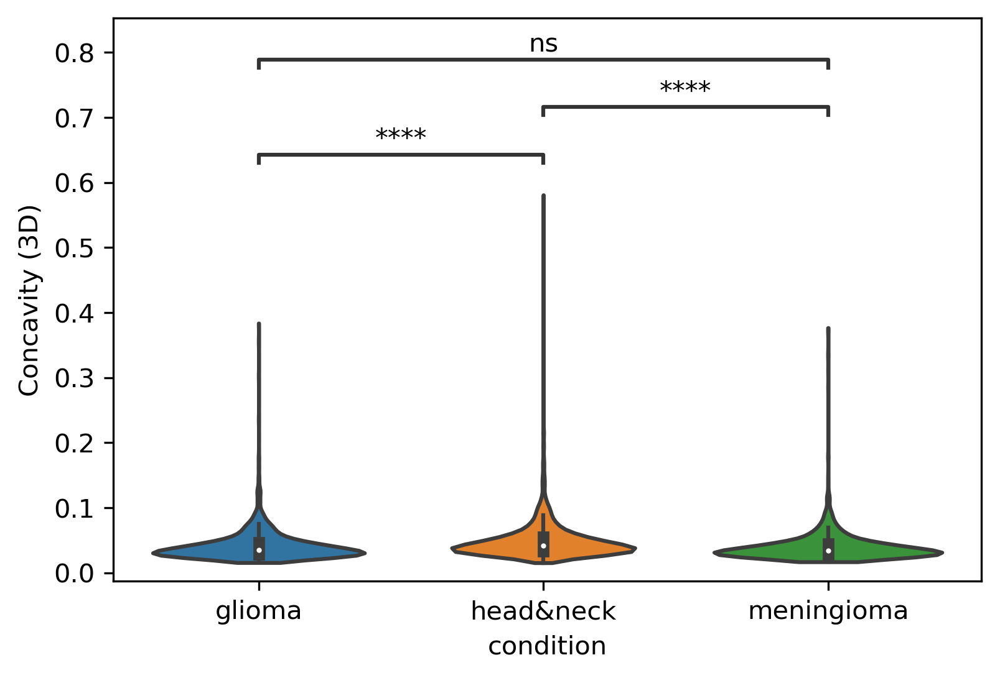

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:3.972e-32 t=-1.192e+01
head&neck vs. meningioma: t-test independent samples, P_val:3.107e-63 t=1.715e+01
glioma vs. meningioma: t-test independent samples, P_val:1.065e-05 t=4.410e+00


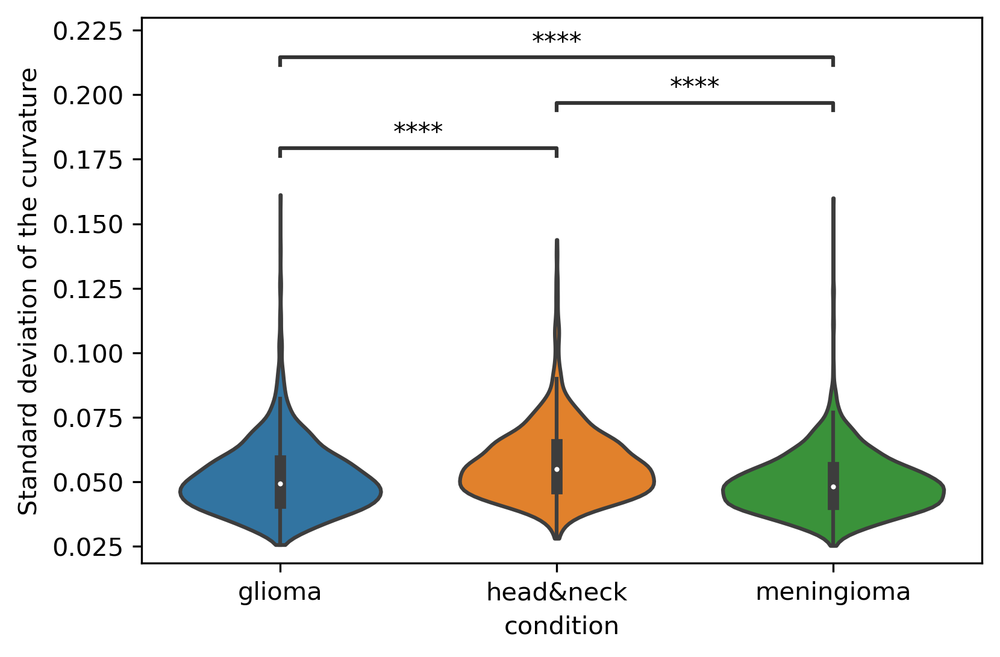

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:4.614e-111 t=-2.326e+01
head&neck vs. meningioma: t-test independent samples, P_val:1.205e-167 t=2.924e+01
glioma vs. meningioma: t-test independent samples, P_val:3.749e-04 t=3.561e+00


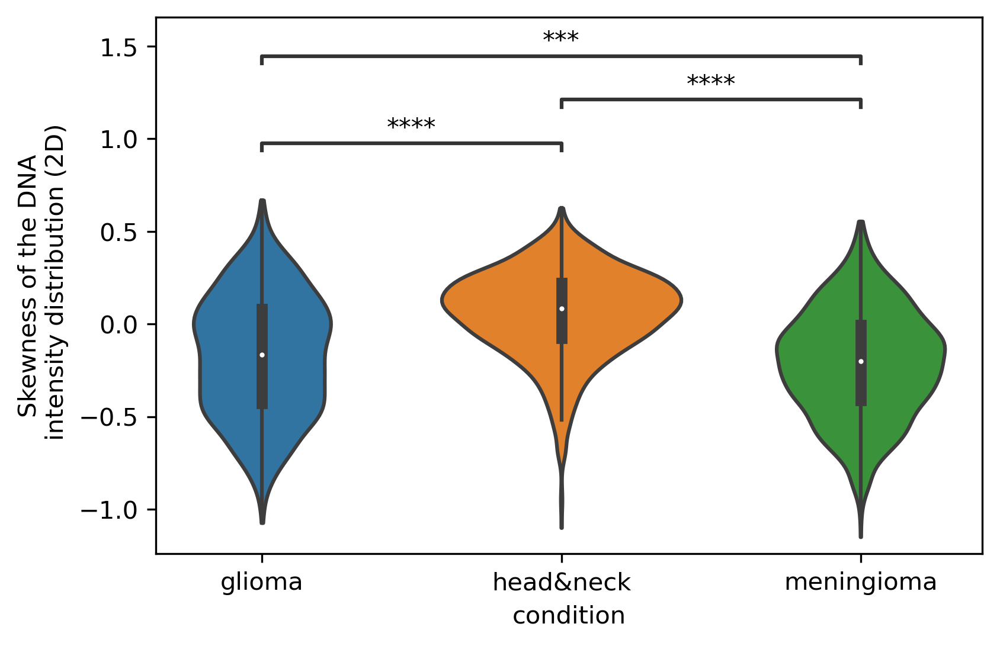

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:7.144e-01 t=-3.660e-01
head&neck vs. meningioma: t-test independent samples, P_val:2.309e-06 t=-4.733e+00
glioma vs. meningioma: t-test independent samples, P_val:5.676e-07 t=-5.012e+00


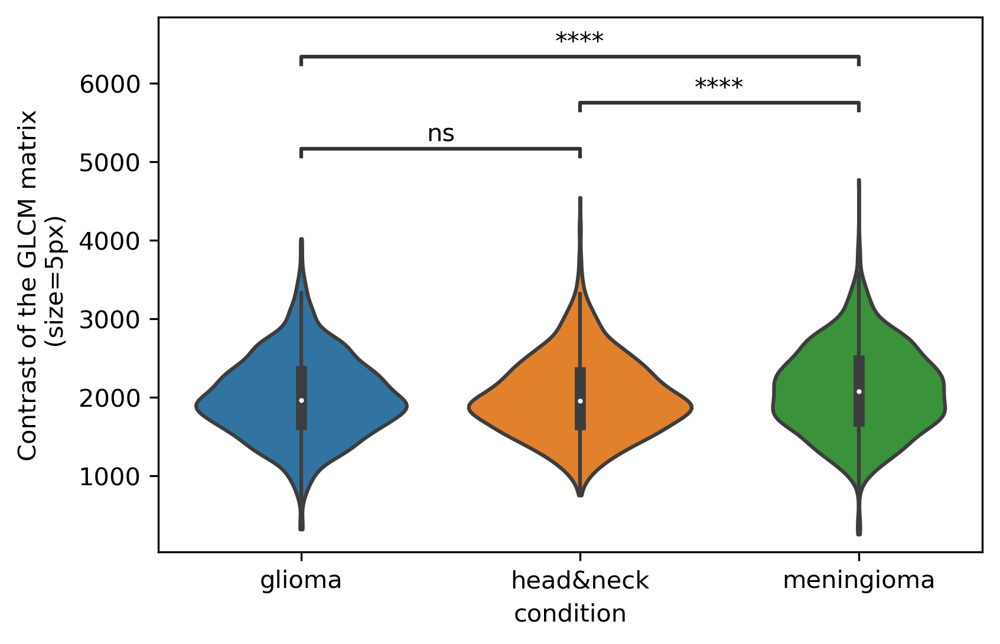

<IPython.core.display.Javascript object>

In [66]:
markers = [
    "nuclear_volume",
    "hc_ec_ratio_3d",
    "concavity",
    "std_curvature",
    "skewness",
    "contrast_5",
]
marker_labels = [
    r"Nuclear volume in px$^3$",
    "relative HC/EC ratio",
    "Concavity (3D)",
    "Standard deviation of the curvature",
    "Skewness of the DNA\n intensity distribution (2D)",
    "Contrast of the GLCM matrix\n (size=5px)",
]
plot_cancer_type_markers_dist(rep1_data, markers, marker_labels, cut=0)

---

#### Data set 2

In [67]:
marker_screen_rep2_results = find_markers(chrometric_rep2_data, rep2_cancer_labels)

Run marker screen: 100%|██████████| 3/3 [00:00<00:00, 12.70it/s]


<IPython.core.display.Javascript object>

In [68]:
marker_screen_rep2_results.loc[marker_screen_rep2_results.label == "glioma"].head(10)

,label,marker,fc,abs_delta_fc,pval,pval_adjust
18,glioma,contrast_5,0.881428,0.118572,2.532996e-75,2.051727e-73
52,glioma,rel_hc_volume,0.987298,0.012702,1.512831e-22,3.501123e-21
4,glioma,med_radius,1.013147,0.013147,4.229077e-15,4.281940e-14
24,glioma,weighted_moments_normalized-0-2,1.051896,0.051896,9.059048e-15,8.632740e-14
30,glioma,weighted_moments_normalized-2-2,1.083234,0.083234,1.866290e-12,1.439709e-11
21,glioma,correlation_5,1.014197,0.014197,2.563106e-12,1.887378e-11
23,glioma,weighted_moments-0-0,0.971771,0.028229,1.565173e-10,1.098537e-09
28,glioma,weighted_moments_normalized-2-0,1.040428,0.040428,9.162182e-10,5.708744e-09
0,glioma,min_calliper,1.012350,0.012350,6.435855e-08,3.363253e-07
7,glioma,std_curvature,1.030254,0.030254,1.607784e-07,7.892756e-07


<IPython.core.display.Javascript object>

In [69]:
marker_screen_rep2_results.loc[marker_screen_rep2_results.label == "head&neck"].head(10)

,label,marker,fc,abs_delta_fc,pval,pval_adjust
52,head&neck,rel_hc_volume,0.981148,0.018852,3.145567e-34,1.019164e-32
18,head&neck,contrast_5,1.071512,0.071512,6.818133e-20,1.227264e-18
21,head&neck,correlation_5,1.018106,0.018106,1.979705e-18,2.467017e-17
7,head&neck,std_curvature,1.046297,0.046297,2.157408e-15,2.496429e-14
23,head&neck,weighted_moments-0-0,1.037866,0.037866,4.214436e-15,4.281940e-14
24,head&neck,weighted_moments_normalized-0-2,0.953740,0.046260,7.840774e-13,6.351027e-12
30,head&neck,weighted_moments_normalized-2-2,0.927531,0.072469,1.627462e-10,1.098537e-09
28,head&neck,weighted_moments_normalized-2-0,0.961071,0.038929,4.909429e-09,2.840455e-08
5,head&neck,concavity,1.071322,0.071322,9.323901e-09,5.208524e-08
9,head&neck,max_posi_curv,1.037634,0.037634,2.282842e-08,1.232735e-07


<IPython.core.display.Javascript object>

In [70]:
marker_screen_rep2_results.loc[marker_screen_rep2_results.label == "meningioma"].head(
    10
)

,label,marker,fc,abs_delta_fc,pval,pval_adjust
52,meningioma,rel_hc_volume,1.032067,0.032067,6.337939e-134,1.026746e-131
21,meningioma,correlation_5,0.968213,0.031787,1.108636e-54,5.986636e-53
7,meningioma,std_curvature,0.926310,0.073690,6.052338e-39,2.451197e-37
13,meningioma,num_prominant_neg_curv,0.911755,0.088245,5.312171e-25,1.434286e-23
12,meningioma,num_prominant_pos_curv,0.930173,0.069827,2.012433e-22,4.075178e-21
14,meningioma,frac_peri_w_posi_curvature,1.013861,0.013861,2.179555e-19,3.530880e-18
5,meningioma,concavity,0.893340,0.106660,2.800407e-19,4.124236e-18
11,meningioma,med_neg_curv,0.941016,0.058984,1.406105e-18,1.898242e-17
9,meningioma,max_posi_curv,0.949282,0.050718,3.028696e-14,2.725826e-13
18,meningioma,contrast_5,1.054579,0.054579,7.755920e-14,6.612943e-13


<IPython.core.display.Javascript object>

When assessing the second data set we primarly find the chromatin condensation feature, as well texture and size feature to differ between the individual cancer types.

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:9.903e-01 t=-1.217e-02
head&neck vs. meningioma: t-test independent samples, P_val:2.669e-02 t=2.217e+00
glioma vs. meningioma: t-test independent samples, P_val:1.165e-02 t=2.524e+00


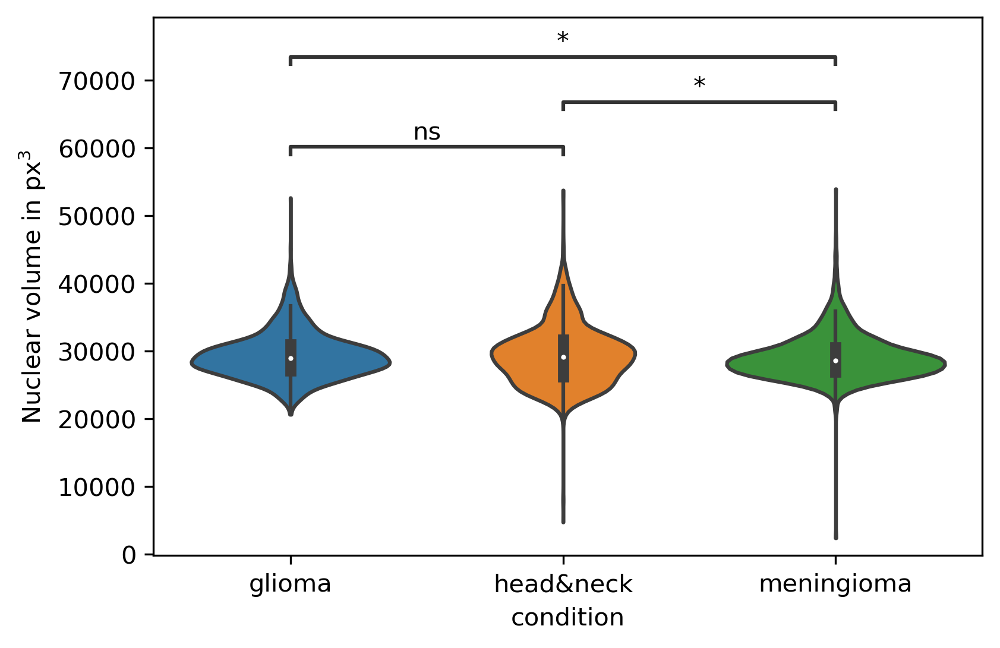

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:1.816e-02 t=2.363e+00
head&neck vs. meningioma: t-test independent samples, P_val:4.565e-88 t=-2.032e+01
glioma vs. meningioma: t-test independent samples, P_val:4.310e-102 t=-2.199e+01


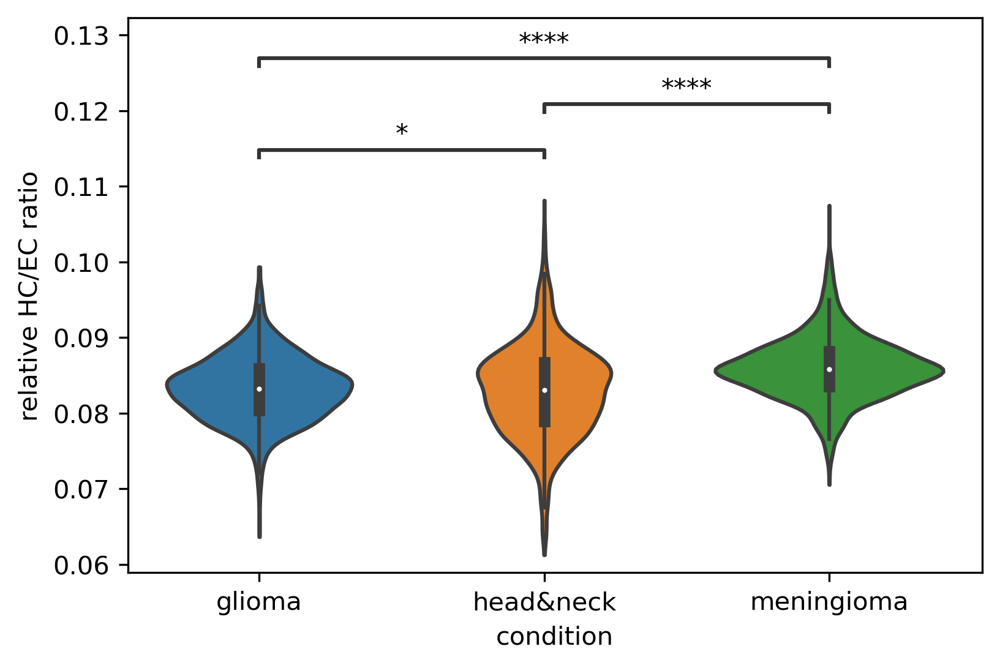

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:1.601e-01 t=-1.405e+00
head&neck vs. meningioma: t-test independent samples, P_val:3.730e-17 t=8.454e+00
glioma vs. meningioma: t-test independent samples, P_val:3.473e-13 t=7.296e+00


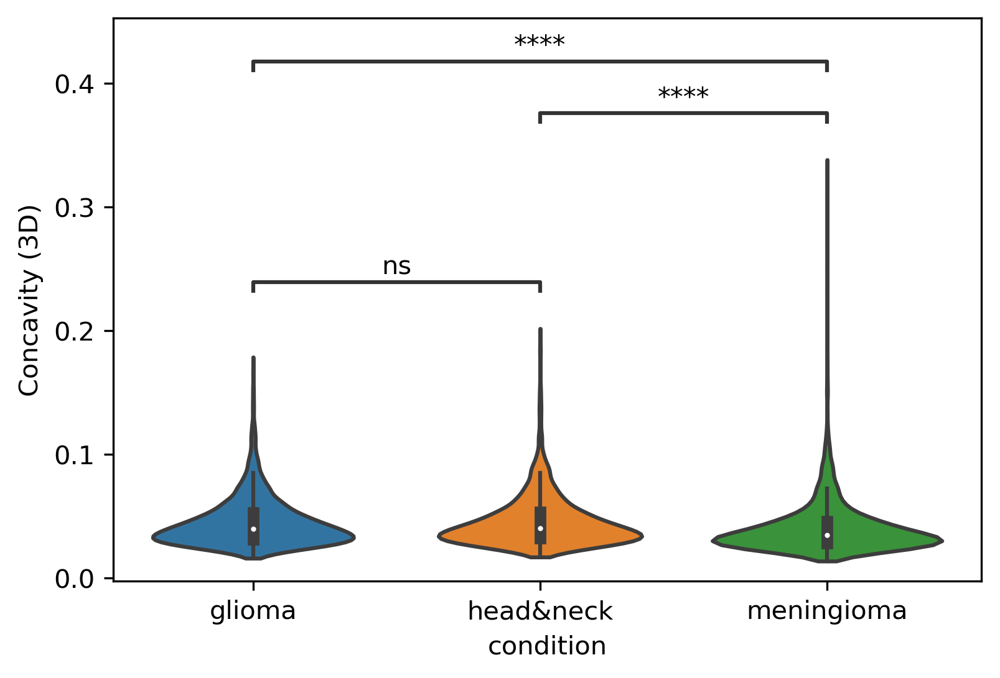

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:1.118e-01 t=-1.591e+00
head&neck vs. meningioma: t-test independent samples, P_val:1.028e-33 t=1.220e+01
glioma vs. meningioma: t-test independent samples, P_val:2.645e-26 t=1.068e+01


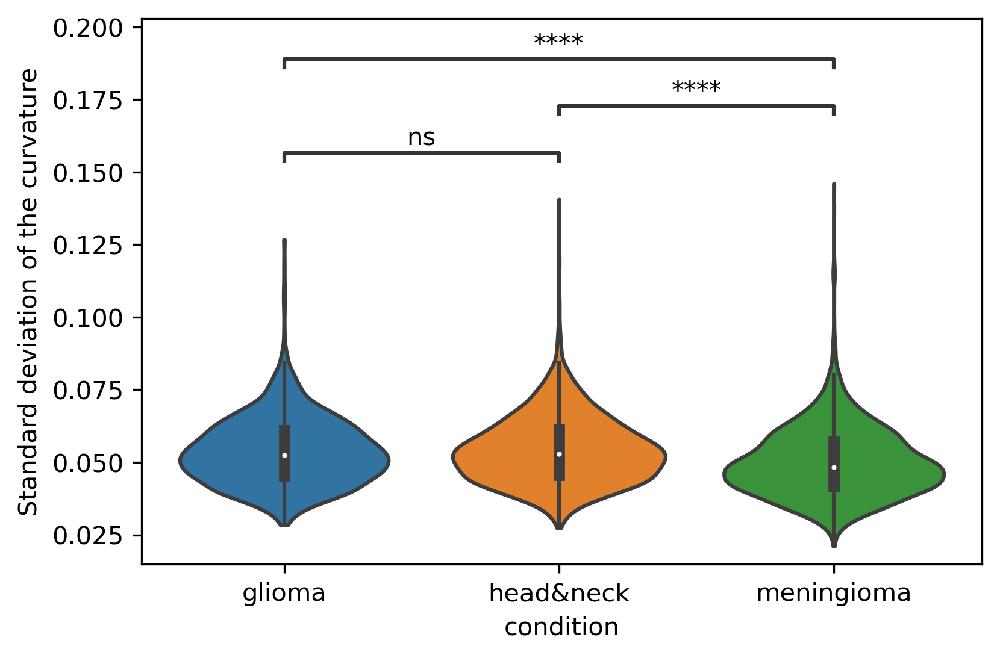

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:5.987e-02 t=-1.882e+00
head&neck vs. meningioma: t-test independent samples, P_val:8.198e-01 t=2.278e-01
glioma vs. meningioma: t-test independent samples, P_val:1.126e-01 t=-1.587e+00


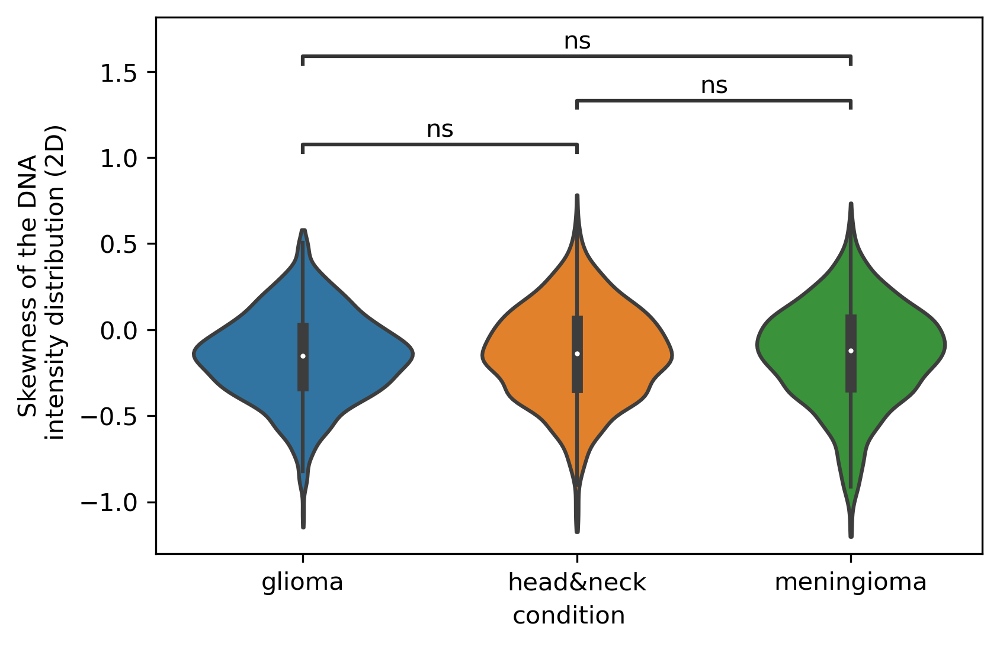

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:4.186e-54 t=-1.569e+01
head&neck vs. meningioma: t-test independent samples, P_val:2.142e-01 t=1.242e+00
glioma vs. meningioma: t-test independent samples, P_val:1.113e-52 t=-1.547e+01


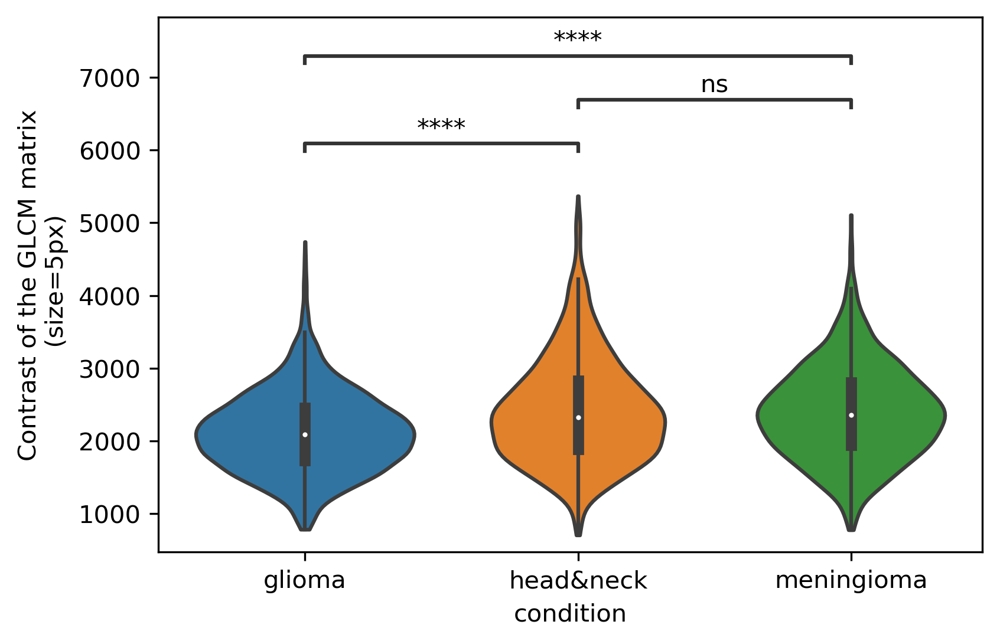

<IPython.core.display.Javascript object>

In [71]:
plot_cancer_type_markers_dist(rep2_data, markers, marker_labels, cut=0)

---

#### Combined data set

In [72]:
marker_screen_results = find_markers(chrometric_data, cancer_labels)

Run marker screen: 100%|██████████| 3/3 [00:00<00:00,  9.76it/s]


<IPython.core.display.Javascript object>

In [73]:
marker_screen_results.loc[marker_screen_results.label == "glioma"].head(10)

,label,marker,fc,abs_delta_fc,pval,pval_adjust
19,glioma,contrast_5,0.917346,0.082654,6.451221e-61,2.322440e-59
58,glioma,rel_hc_volume,0.982298,0.017702,2.080500e-40,2.880693e-39
55,glioma,equivalent_diameter.1,0.991448,0.008552,6.136181e-23,4.602135e-22
22,glioma,correlation_5,1.014540,0.014540,2.112632e-20,1.408421e-19
17,glioma,skewness,1.414468,0.414468,1.057700e-17,6.346203e-17
4,glioma,med_radius,1.009250,0.009250,1.154662e-12,5.938262e-12
0,glioma,min_calliper,1.011933,0.011933,1.873106e-11,9.112410e-11
16,glioma,kurtosis,1.101141,0.101141,1.470090e-09,6.454055e-09
25,glioma,weighted_moments_normalized-0-2,1.031764,0.031764,3.036376e-07,1.162867e-06
21,glioma,homogeneity_100,1.282399,0.282399,3.648353e-07,1.368132e-06


<IPython.core.display.Javascript object>

In [74]:
marker_screen_results.loc[marker_screen_results.label == "head&neck"].head(10)

,label,marker,fc,abs_delta_fc,pval,pval_adjust
55,head&neck,equivalent_diameter.1,1.019666,0.019666,2.945753e-90,5.302355e-88
17,head&neck,skewness,0.352812,0.647188,6.323182e-86,5.690864e-84
8,head&neck,std_curvature,1.081530,0.081530,6.334981e-64,2.850741e-62
58,head&neck,rel_hc_volume,1.018106,0.018106,2.941483e-48,8.824450e-47
16,head&neck,kurtosis,0.804832,0.195168,1.258674e-46,3.236591e-45
15,head&neck,frac_peri_w_posi_curvature,0.984502,0.015498,5.536497e-40,7.118353e-39
10,head&neck,max_posi_curv,1.074599,0.074599,1.794095e-37,2.152914e-36
13,head&neck,num_prominant_pos_curv,1.069404,0.069404,7.526463e-34,7.969196e-33
14,head&neck,num_prominant_neg_curv,1.077664,0.077664,1.689432e-29,1.689432e-28
5,head&neck,concavity,1.117038,0.117038,2.537999e-27,2.175428e-26


<IPython.core.display.Javascript object>

In [75]:
marker_screen_results.loc[marker_screen_results.label == "meningioma"].head(10)

,label,marker,fc,abs_delta_fc,pval,pval_adjust
8,meningioma,std_curvature,0.920310,0.079690,1.215011e-73,7.290064e-72
7,meningioma,avg_curvature,1.024422,0.024422,1.365857e-45,3.073178e-44
13,meningioma,num_prominant_pos_curv,0.923147,0.076853,1.760522e-45,3.521045e-44
14,meningioma,num_prominant_neg_curv,0.909562,0.090438,1.503704e-43,2.706667e-42
15,meningioma,frac_peri_w_posi_curvature,1.015855,0.015855,1.534181e-41,2.510478e-40
55,meningioma,equivalent_diameter.1,0.989078,0.010922,8.046596e-41,1.206989e-39
10,meningioma,max_posi_curv,0.935450,0.064550,1.279200e-36,1.439100e-35
12,meningioma,med_neg_curv,0.943616,0.056384,6.345726e-29,6.011741e-28
5,meningioma,concavity,0.892271,0.107729,8.616856e-28,7.755171e-27
17,meningioma,skewness,1.544776,0.544776,8.853659e-27,7.243902e-26


<IPython.core.display.Javascript object>

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:5.471e-71 t=-1.799e+01
head&neck vs. meningioma: t-test independent samples, P_val:3.758e-95 t=2.098e+01
glioma vs. meningioma: t-test independent samples, P_val:2.379e-02 t=2.261e+00


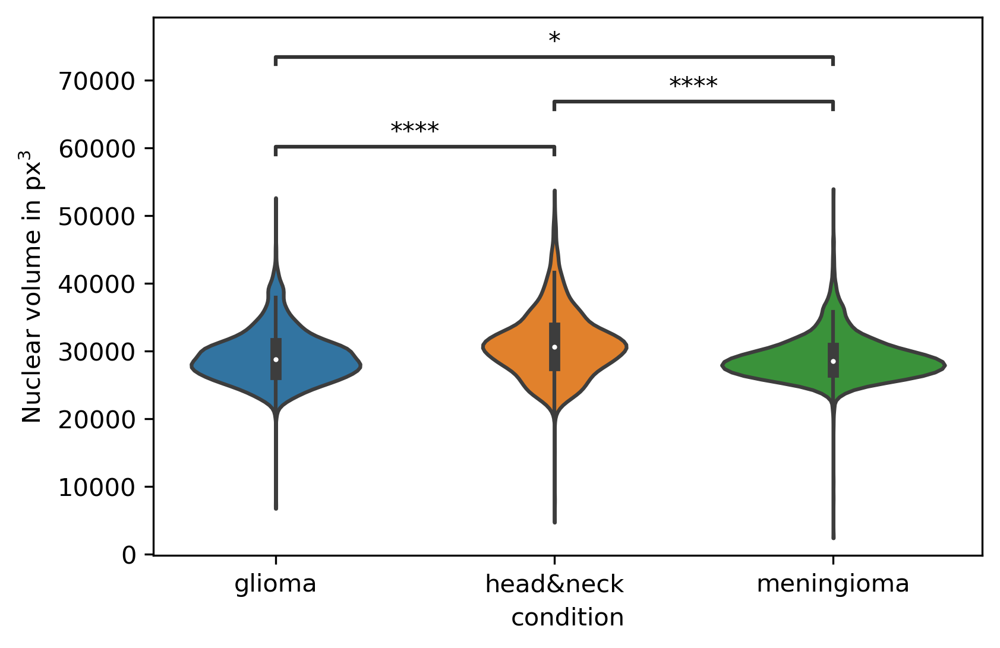

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:3.471e-57 t=-1.607e+01
head&neck vs. meningioma: t-test independent samples, P_val:3.308e-18 t=8.721e+00
glioma vs. meningioma: t-test independent samples, P_val:1.152e-14 t=-7.736e+00


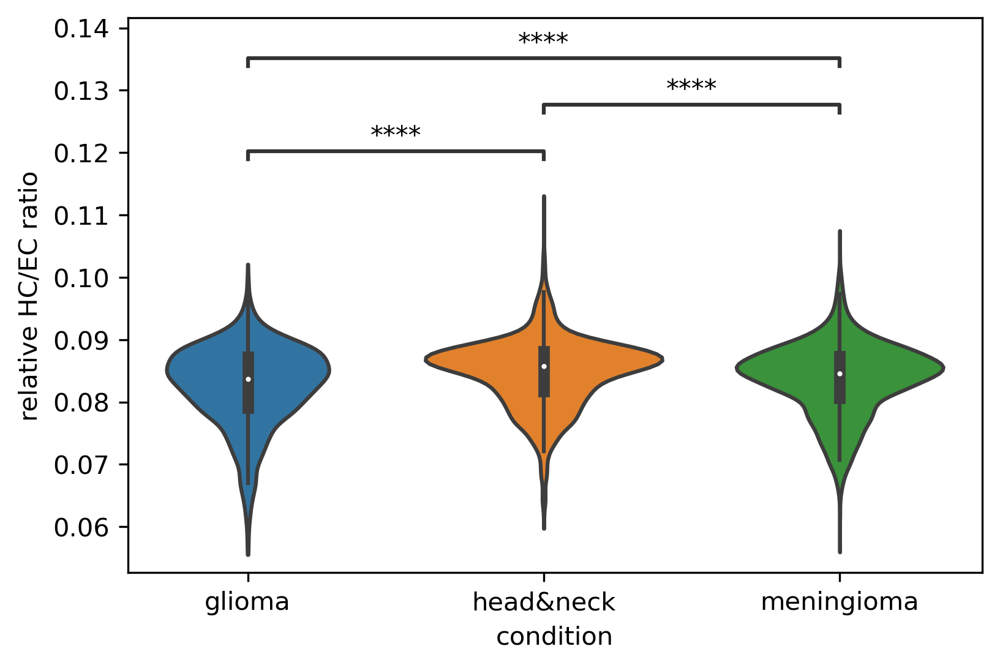

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:9.854e-11 t=-6.478e+00
head&neck vs. meningioma: t-test independent samples, P_val:2.150e-35 t=1.248e+01
glioma vs. meningioma: t-test independent samples, P_val:1.284e-10 t=6.437e+00


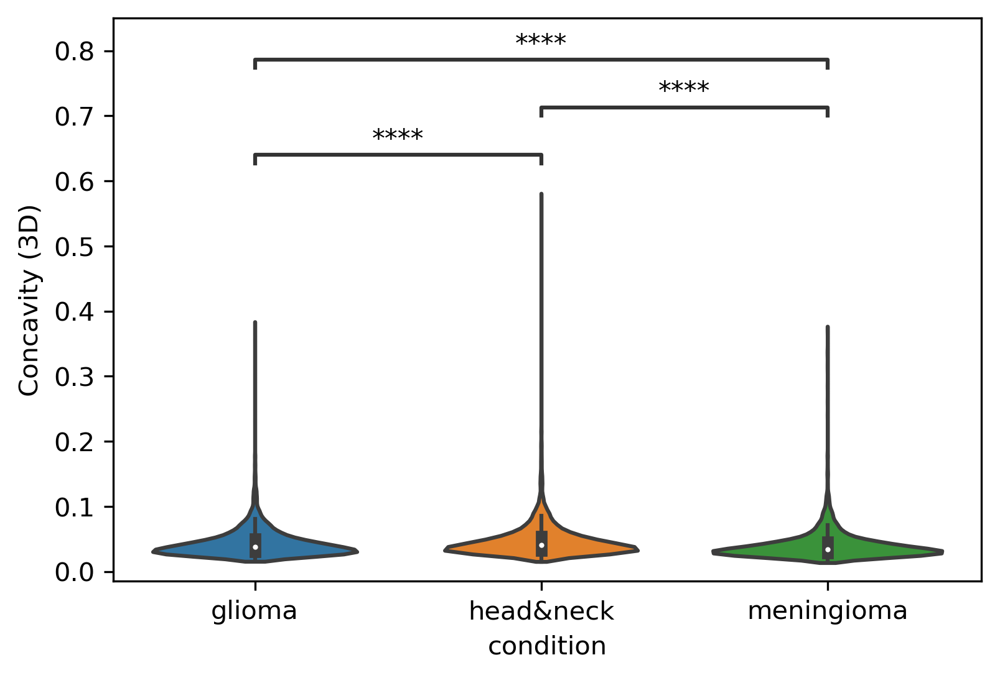

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:3.103e-21 t=-9.486e+00
head&neck vs. meningioma: t-test independent samples, P_val:3.435e-91 t=2.051e+01
glioma vs. meningioma: t-test independent samples, P_val:3.170e-27 t=1.085e+01


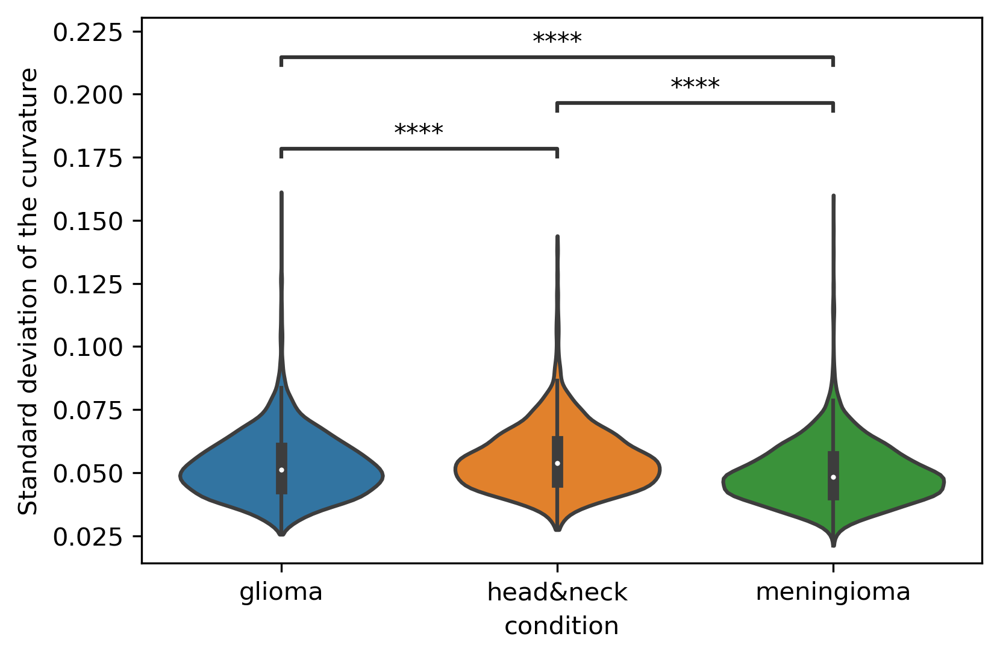

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:2.346e-60 t=-1.653e+01
head&neck vs. meningioma: t-test independent samples, P_val:1.929e-68 t=1.765e+01
glioma vs. meningioma: t-test independent samples, P_val:1.900e-01 t=1.311e+00


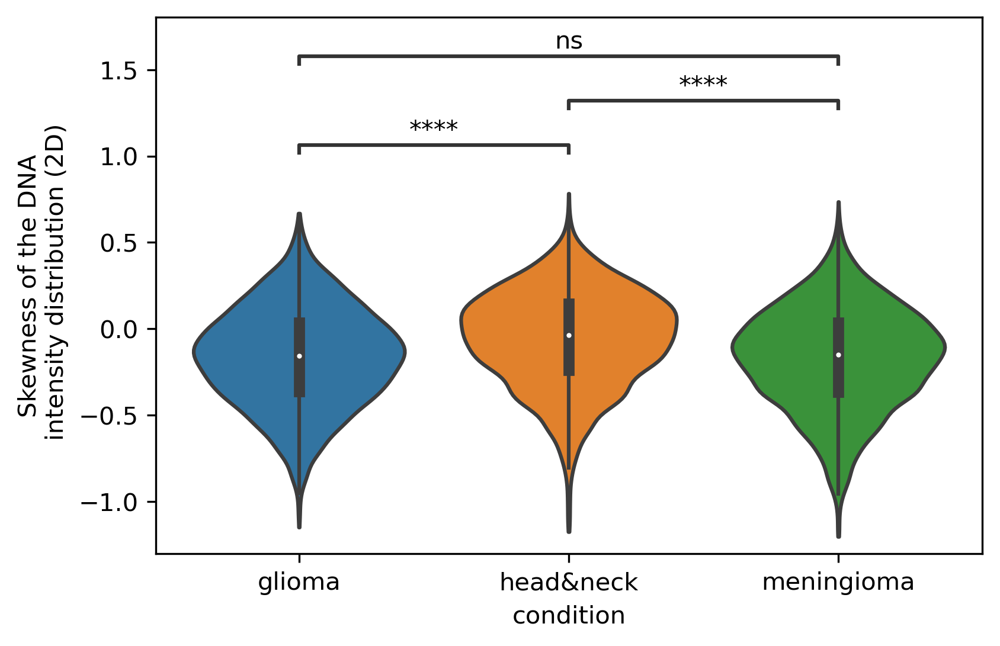

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:2.111e-37 t=-1.285e+01
head&neck vs. meningioma: t-test independent samples, P_val:1.401e-01 t=-1.476e+00
glioma vs. meningioma: t-test independent samples, P_val:9.529e-51 t=-1.509e+01


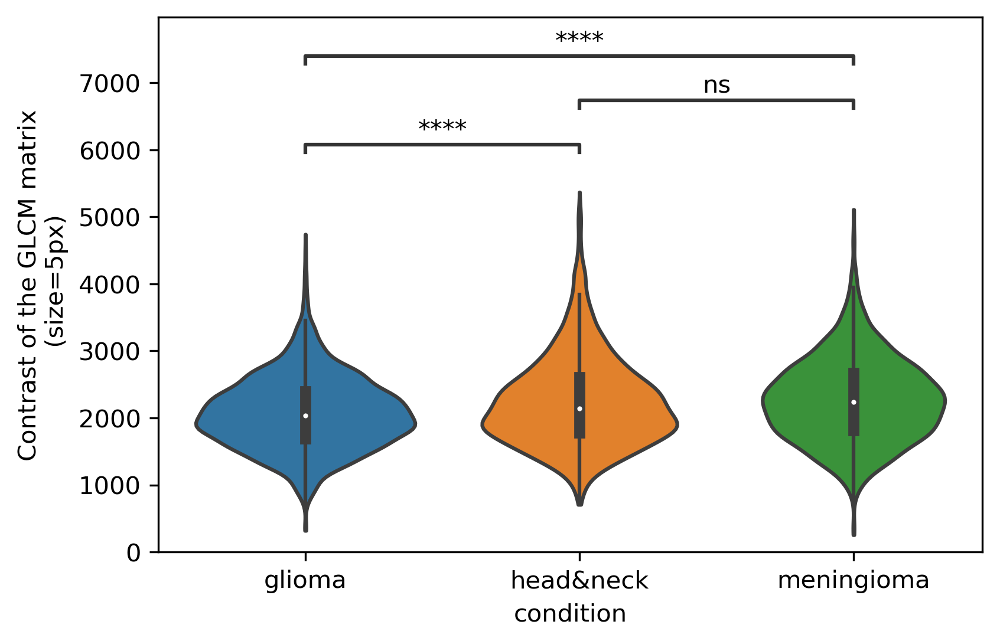

<IPython.core.display.Javascript object>

In [76]:
plot_cancer_type_markers_dist(data, markers, marker_labels, cut=0)

---

### 3d. Proteomic differences of PBMCs in cancer

Finally, we also assess the proteomic differences between the control and cancer populations. To this end, we plot the relative Lamin and gH2AX expression measured by the sum of the intensities of the corresponding imaging channels normalized by the nuclear volume. Additionally, we plot the number of identified gH2AX foci which are computed as the local maxima peaks found in the corresponding channel images.

Note that those features are only available for the first data set that was stained for those proteins.

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:3.701e-01 t=-8.963e-01
head&neck vs. meningioma: t-test independent samples, P_val:6.150e-02 t=1.871e+00
glioma vs. meningioma: t-test independent samples, P_val:4.459e-01 t=7.624e-01


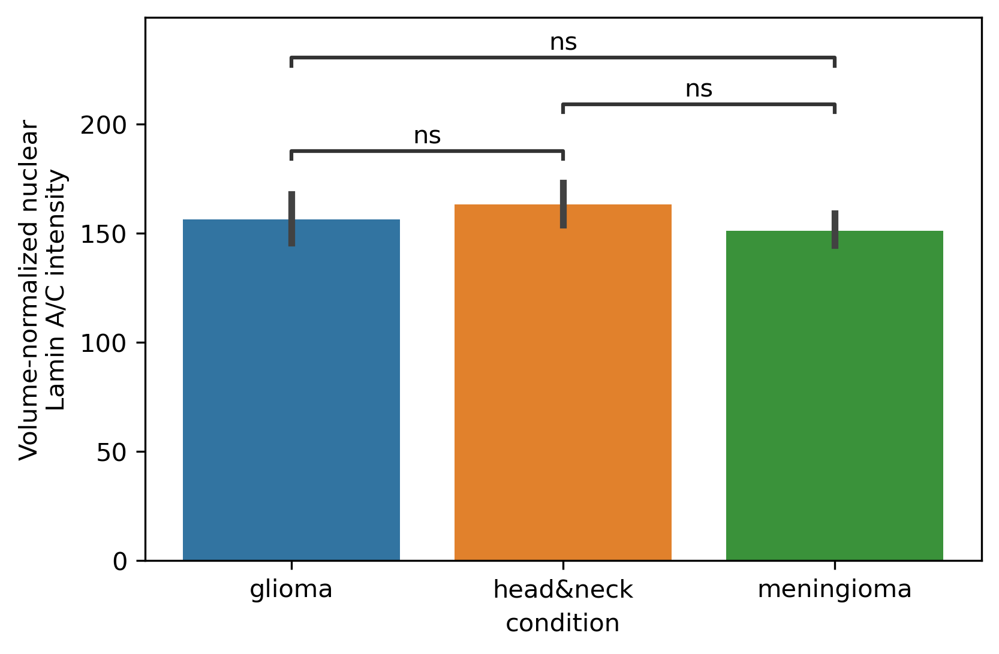

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:8.612e-06 t=4.456e+00
head&neck vs. meningioma: t-test independent samples, P_val:7.069e-03 t=2.695e+00
glioma vs. meningioma: t-test independent samples, P_val:3.863e-29 t=1.131e+01


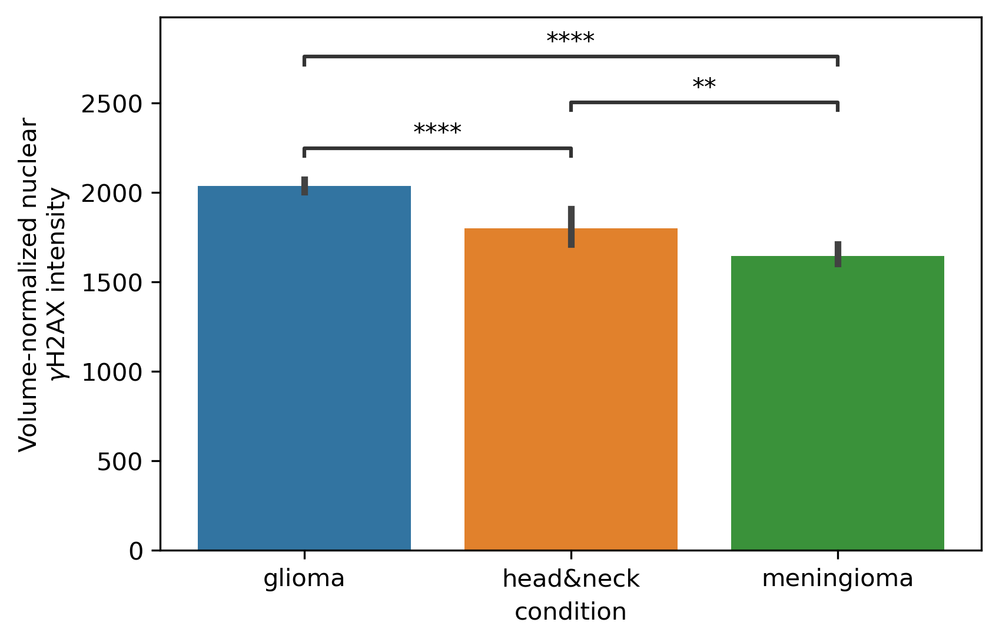

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

glioma vs. head&neck: t-test independent samples, P_val:2.097e-08 t=5.617e+00
head&neck vs. meningioma: t-test independent samples, P_val:1.152e-02 t=-2.528e+00
glioma vs. meningioma: t-test independent samples, P_val:2.494e-03 t=3.026e+00


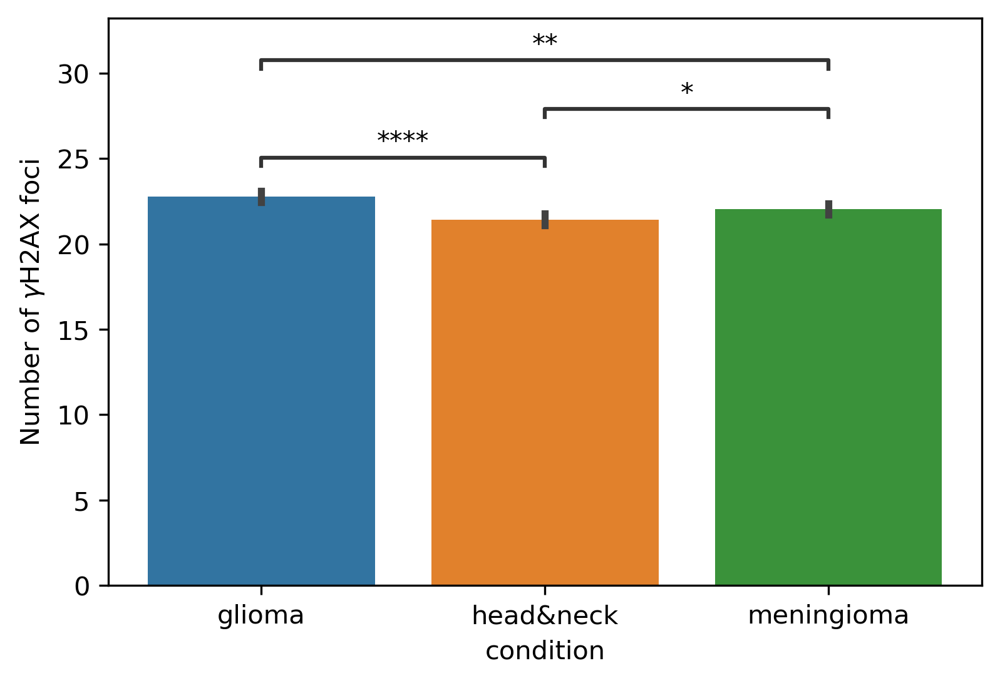

<IPython.core.display.Javascript object>

In [77]:
markers = ["rel_lamin_3d_int", "rel_gh2ax_3d_int", "gh2ax_foci_count"]
marker_labels = [
    "Volume-normalized nuclear\nLamin A/C intensity",
    "Volume-normalized nuclear\n" r"$\gamma$H2AX intensity",
    r"Number of $\gamma$H2AX foci",
]
plot_cancer_type_markers_dist(
    rep1_data, markers, marker_labels, quantiles=None, cut=0, plot_type="bar"
)

---

## 4. Supplemental